In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import matplotlib.ticker as ticker
from IPython.display import Audio
from sklearn import datasets, linear_model
from sklearn.decomposition import PCA
from sklearn.preprocessing import MinMaxScaler
from sklearn.manifold import TSNE

In [19]:
df = pd.read_csv('Hot Stuff.csv')
pd.set_option('display.max_columns', 50)
pd.set_option('display.max_colwidth', 200)

In [20]:
df.tail(5)

,url,WeekID,Week Position,Song,Performer,SongID,Instance,Previous Week Position,Peak Position,Weeks on Chart
327890,https://www.billboard.com/charts/hot-100/2018-10-20,10/20/2018,22,God Is A Woman,Ariana Grande,God Is A WomanAriana Grande,1,21.0,8,13
327891,http://www.billboard.com/charts/hot-100/1977-05-21,5/21/1977,22,I Wanna Get Next To You,Rose Royce,I Wanna Get Next To YouRose Royce,1,10.0,10,13
327892,http://www.billboard.com/charts/hot-100/1981-05-23,5/23/1981,22,I Can't Stand It,Eric Clapton And His Band,I Can't Stand ItEric Clapton And His Band,1,12.0,10,13
327893,http://www.billboard.com/charts/hot-100/1973-09-29,9/29/1973,22,Here I Am Come & Take Me,Al Green,Here I Am Come & Take MeAl Green,1,16.0,10,13
327894,https://www.billboard.com/charts/hot-100/2020-11-28,11/28/2020,22,Hawai,Maluma & The Weeknd,HawaiMaluma & The Weeknd,1,12.0,12,13


In [21]:
df.describe()

,Week Position,Instance,Previous Week Position,Peak Position,Weeks on Chart
count,327895.000000,327895.000000,295941.000000,327895.000000,327895.000000
mean,50.499309,1.072538,47.604066,41.358307,9.153793
std,28.865707,0.334188,28.056915,29.542497,7.590281
min,1.000000,1.000000,1.000000,1.000000,1.000000
25%,25.500000,1.000000,23.000000,14.000000,4.000000
50%,50.000000,1.000000,47.000000,39.000000,7.000000
75%,75.000000,1.000000,72.000000,66.000000,13.000000
max,100.000000,10.000000,100.000000,100.000000,87.000000


In [22]:
#convert WeekID to date_time object for sorting by time
df['WeekID'] = pd.to_datetime(df['WeekID'])

In [23]:
df.sort_values(by='WeekID')

,url,WeekID,Week Position,Song,Performer,SongID,Instance,Previous Week Position,Peak Position,Weeks on Chart
18553,http://www.billboard.com/charts/hot-100/1958-08-02,1958-08-02,63,High School Confidential,Jerry Lee Lewis And His Pumping Piano,High School ConfidentialJerry Lee Lewis And His Pumping Piano,1,NaN,63,1
103337,http://www.billboard.com/charts/hot-100/1958-08-02,1958-08-02,98,Little Serenade,The Ames Brothers,Little SerenadeThe Ames Brothers,1,NaN,98,1
146293,http://www.billboard.com/charts/hot-100/1958-08-02,1958-08-02,68,Volare (Nel Blu Dipinto Di Blu),Dean Martin,Volare (Nel Blu Dipinto Di Blu)Dean Martin,1,NaN,68,1
944,http://www.billboard.com/charts/hot-100/1958-08-02,1958-08-02,1,Poor Little Fool,Ricky Nelson,Poor Little FoolRicky Nelson,1,NaN,1,1
8057,http://www.billboard.com/charts/hot-100/1958-08-02,1958-08-02,47,I Wonder Why,Dion & The Belmonts,I Wonder WhyDion & The Belmonts,1,NaN,47,1
...,...,...,...,...,...,...,...,...,...,...
205295,https://www.billboard.com/charts/hot-100/2021-05-29,2021-05-29,29,Calling My Phone,Lil Tjay Featuring 6LACK,Calling My PhoneLil Tjay Featuring 6LACK,1,13.0,3,14
65994,https://www.billboard.com/charts/hot-100/2021-05-29,2021-05-29,90,Shottas (Lala),Moneybagg Yo,Shottas (Lala)Moneybagg Yo,1,72.0,35,4
50052,https://www.billboard.com/charts/hot-100/2021-05-29,2021-05-29,99,Country Again,Thomas Rhett,Country AgainThomas Rhett,1,95.0,73,3
300806,https://www.billboard.com/charts/hot-100/2021-05-29,2021-05-29,61,Almost Maybes,Jordan Davis,Almost MaybesJordan Davis,2,64.0,61,17


In [24]:
#Number of Unique values by Column
df.apply(pd.Series.nunique)

url                        3279
WeekID                     3279
Week Position               100
Song                      24360
Performer                 10061
SongID                    29389
Instance                     10
Previous Week Position      100
Peak Position               100
Weeks on Chart               87
dtype: int64

In [25]:
unique_song1 = df['SongID'].unique()

In [26]:
type(unique_song1)

numpy.ndarray

In [27]:
np.count_nonzero(unique_song1)

29389

In [28]:
a = list(unique_song1)

In [3]:
df2 = pd.read_excel('Hot 100 Audio Features.xlsx')

In [4]:
df2.head(5)

,SongID,Performer,Song,spotify_genre,spotify_track_id,spotify_track_preview_url,spotify_track_duration_ms,spotify_track_explicit,spotify_track_album,danceability,...,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,spotify_track_popularity
0,-twistin'-White Silver SandsBill Black's Combo,Bill Black's Combo,-twistin'-White Silver Sands,[],NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,¿Dònde Està Santa Claus? (Where Is Santa Claus...,Augie Rios,¿Dònde Està Santa Claus? (Where Is Santa Claus?),['novelty'],NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,......And Roses And RosesAndy Williams,Andy Williams,......And Roses And Roses,"['adult standards', 'brill building pop', 'eas...",3tvqPPpXyIgKrm4PR9HCf0,https://p.scdn.co/mp3-preview/cef4883cfd1e0e53...,166106.0,0.0,The Essential Andy Williams,0.154,...,-14.063,1.0,0.0315,0.91100,0.000267,0.112,0.150,83.969,4.0,38.0
3,...And Then There Were DrumsSandy Nelson,Sandy Nelson,...And Then There Were Drums,"['rock-and-roll', 'space age pop', 'surf music']",1fHHq3qHU8wpRKHzhojZ4a,NaN,172066.0,0.0,Compelling Percussion,0.588,...,-17.278,0.0,0.0361,0.00256,0.745000,0.145,0.801,121.962,4.0,11.0
4,...Baby One More TimeBritney Spears,Britney Spears,...Baby One More Time,"['dance pop', 'pop', 'post-teen pop']",3MjUtNVVq3C8Fn0MP3zhXa,https://p.scdn.co/mp3-preview/da2134a161f1cb34...,211066.0,0.0,...Baby One More Time (Digital Deluxe Version),0.759,...,-5.745,0.0,0.0307,0.20200,0.000131,0.443,0.907,92.960,4.0,77.0


In [111]:
clean_series = df2['spotify_genre'].replace('[]', np.nan).dropna()
clean_series.head()

1                                          ['novelty']
2    ['adult standards', 'brill building pop', 'eas...
3     ['rock-and-roll', 'space age pop', 'surf music']
4                ['dance pop', 'pop', 'post-teen pop']
5                             ['pop', 'post-teen pop']
Name: spotify_genre, dtype: object

In [82]:
type(clean_series)

pandas.core.series.Series

In [152]:
new = []

for item in clean_series:
    for ch in ['\\','`','*','_','{','}','[',']','(',')','>','#','+','.','!','$','\'']:

        if ch in item:
            item = item.replace(ch,'')
    new.append(item)
    #print (item)

In [153]:
new

['novelty',
 'adult standards, brill building pop, easy listening, mellow gold',
 'rock-and-roll, space age pop, surf music',
 'dance pop, pop, post-teen pop',
 'pop, post-teen pop',
 'east coast hip hop, hip hop, pop rap, rap, southern hip hop',
 'album rock, bubblegum pop, country rock, folk rock, mellow gold, new wave pop, soft rock, yacht rock',
 'english indie rock',
 'country, country dawn, nashville sound',
 'funk, motown, neo soul, new jack swing, quiet storm, r&b, soul, urban contemporary',
 'australian country, contemporary country, country, country road',
 'funk, neo soul, new jack swing, quiet storm, r&b, urban contemporary',
 'blues rock, garage rock, modern blues rock, neo-psychedelic, nu gaze, punk blues',
 'pop, post-teen pop',
 'adult standards, brill building pop, folk, folk rock, mellow gold, singer-songwriter, soft rock, yacht rock',
 'memphis soul, southern soul',
 'classic soul, disco, funk, jazz funk, memphis soul, motown, quiet storm, soul, southern soul',
 'adu

In [192]:
type(new)

list

In [154]:
string = ', '.join(new)

In [155]:
len(string)

1594124

In [156]:
string

'novelty, adult standards, brill building pop, easy listening, mellow gold, rock-and-roll, space age pop, surf music, dance pop, pop, post-teen pop, pop, post-teen pop, east coast hip hop, hip hop, pop rap, rap, southern hip hop, album rock, bubblegum pop, country rock, folk rock, mellow gold, new wave pop, soft rock, yacht rock, english indie rock, country, country dawn, nashville sound, funk, motown, neo soul, new jack swing, quiet storm, r&b, soul, urban contemporary, australian country, contemporary country, country, country road, funk, neo soul, new jack swing, quiet storm, r&b, urban contemporary, blues rock, garage rock, modern blues rock, neo-psychedelic, nu gaze, punk blues, pop, post-teen pop, adult standards, brill building pop, folk, folk rock, mellow gold, singer-songwriter, soft rock, yacht rock, memphis soul, southern soul, classic soul, disco, funk, jazz funk, memphis soul, motown, quiet storm, soul, southern soul, adult standards, disco, funk, jazz funk, motown, quiet 

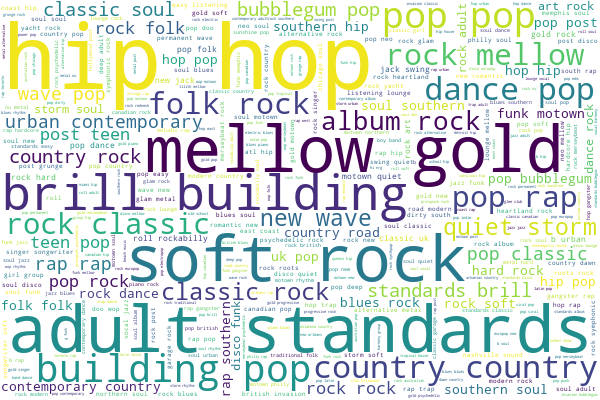

In [158]:
# Import the wordcloud library
from wordcloud import WordCloud

# Create a WordCloud object
wordcloud = WordCloud(background_color="white", max_words=5000, 
                      contour_width=3, contour_color='steelblue',
                       width=600, height=400)

# Generate a word cloud
wordcloud.generate(string)

# Visualize the word cloud
wordcloud.to_image()

In [170]:
a = [item.strip() for item in string.split(',')]

In [174]:
type(a)

list

In [175]:
a

['novelty',
 'adult standards',
 'brill building pop',
 'easy listening',
 'mellow gold',
 'rock-and-roll',
 'space age pop',
 'surf music',
 'dance pop',
 'pop',
 'post-teen pop',
 'pop',
 'post-teen pop',
 'east coast hip hop',
 'hip hop',
 'pop rap',
 'rap',
 'southern hip hop',
 'album rock',
 'bubblegum pop',
 'country rock',
 'folk rock',
 'mellow gold',
 'new wave pop',
 'soft rock',
 'yacht rock',
 'english indie rock',
 'country',
 'country dawn',
 'nashville sound',
 'funk',
 'motown',
 'neo soul',
 'new jack swing',
 'quiet storm',
 'r&b',
 'soul',
 'urban contemporary',
 'australian country',
 'contemporary country',
 'country',
 'country road',
 'funk',
 'neo soul',
 'new jack swing',
 'quiet storm',
 'r&b',
 'urban contemporary',
 'blues rock',
 'garage rock',
 'modern blues rock',
 'neo-psychedelic',
 'nu gaze',
 'punk blues',
 'pop',
 'post-teen pop',
 'adult standards',
 'brill building pop',
 'folk',
 'folk rock',
 'mellow gold',
 'singer-songwriter',
 'soft rock',
 '

In [180]:
new_string = ','.join(a)

In [184]:
new_string

'novelty,adult standards,brill building pop,easy listening,mellow gold,rock-and-roll,space age pop,surf music,dance pop,pop,post-teen pop,pop,post-teen pop,east coast hip hop,hip hop,pop rap,rap,southern hip hop,album rock,bubblegum pop,country rock,folk rock,mellow gold,new wave pop,soft rock,yacht rock,english indie rock,country,country dawn,nashville sound,funk,motown,neo soul,new jack swing,quiet storm,r&b,soul,urban contemporary,australian country,contemporary country,country,country road,funk,neo soul,new jack swing,quiet storm,r&b,urban contemporary,blues rock,garage rock,modern blues rock,neo-psychedelic,nu gaze,punk blues,pop,post-teen pop,adult standards,brill building pop,folk,folk rock,mellow gold,singer-songwriter,soft rock,yacht rock,memphis soul,southern soul,classic soul,disco,funk,jazz funk,memphis soul,motown,quiet storm,soul,southern soul,adult standards,disco,funk,jazz funk,motown,quiet storm,soul,adult standards,brill building pop,bubblegum pop,folk rock,lounge,mel

In [182]:
type(new_string)

str

In [190]:
word_freq = {}

def freq(str):
  
    # break the string into list of words 
    str = str.split(',')         
    str2 = []
  
    # loop till string values present in list str
    for i in str:             
  
        # checking for the duplicacy
        if i not in str2:
  
            # insert value in str2
            str2.append(i) 
              
    for i in range(0, len(str2)):
  
        # count the frequency of each word(present 
        # in str2) in str and print
        print('Frequency of', str2[i], 'is :', str.count(str2[i]))
        

In [191]:
freq(new_string)

Frequency of novelty is : 87
Frequency of adult standards is : 3724
Frequency of brill building pop is : 3305
Frequency of easy listening is : 802
Frequency of mellow gold is : 3961
Frequency of rock-and-roll is : 1964
Frequency of space age pop is : 35
Frequency of surf music is : 92
Frequency of dance pop is : 3095
Frequency of pop is : 3028
Frequency of post-teen pop is : 1561
Frequency of east coast hip hop is : 381
Frequency of hip hop is : 2175
Frequency of pop rap is : 2593
Frequency of rap is : 2559
Frequency of southern hip hop is : 1183
Frequency of album rock is : 2433
Frequency of bubblegum pop is : 2086
Frequency of country rock is : 1390
Frequency of folk rock is : 2538
Frequency of new wave pop is : 1484
Frequency of soft rock is : 3782
Frequency of yacht rock is : 659
Frequency of english indie rock is : 1
Frequency of country is : 1760
Frequency of country dawn is : 381
Frequency of nashville sound is : 370
Frequency of funk is : 1943
Frequency of motown is : 2769
Freq

Frequency of viral pop is : 178
Frequency of deep talent show is : 42
Frequency of new orleans funk is : 26
Frequency of dixieland is : 12
Frequency of jazz clarinet is : 2
Frequency of new orleans jazz is : 8
Frequency of american folk revival is : 81
Frequency of zolo is : 50
Frequency of britpop is : 24
Frequency of scottish new wave is : 16
Frequency of new jersey indie is : 4
Frequency of country pop is : 161
Frequency of classical performance is : 20
Frequency of orchestral performance is : 20
Frequency of deep disco is : 54
Frequency of cantautor is : 3
Frequency of latin arena pop is : 11
Frequency of mexican pop is : 64
Frequency of rock en espanol is : 11
Frequency of spanish pop is : 2
Frequency of swamp pop is : 47
Frequency of appalachian folk is : 23
Frequency of old-time is : 23
Frequency of traditional country is : 73
Frequency of yodeling is : 51
Frequency of alberta country is : 21
Frequency of canadian contemporary country is : 13
Frequency of sydney indie is : 1
Fre

Frequency of free jazz is : 5
Frequency of jazz piano is : 11
Frequency of stride is : 3
Frequency of dark trap is : 5
Frequency of retro electro is : 4
Frequency of rare groove is : 31
Frequency of classic soundtrack is : 11
Frequency of canadian ccm is : 2
Frequency of christian punk is : 3
Frequency of afrobeat is : 17
Frequency of deep smooth jazz is : 1
Frequency of idol rock is : 6
Frequency of j-poprock is : 5
Frequency of anthem worship is : 7
Frequency of ccm is : 27
Frequency of christian pop is : 9
Frequency of worship is : 25
Frequency of bassline is : 2
Frequency of australian alternative rock is : 10
Frequency of bakersfield sound is : 21
Frequency of social media pop is : 63
Frequency of norwegian hip hop is : 1
Frequency of uk alternative hip hop is : 2
Frequency of cedm is : 4
Frequency of hawaiian hip hop is : 3
Frequency of vapor trap is : 21
Frequency of bhangra is : 1
Frequency of desi hip hop is : 3
Frequency of corrido is : 3
Frequency of deep regional mexican is

Frequency of boom bap is : 4
Frequency of post-metal is : 2
Frequency of progressive metal is : 4
Frequency of latin afrobeat is : 3
Frequency of deep ccm is : 1
Frequency of breakbeat is : 3
Frequency of folk metal is : 2
Frequency of german metal is : 8
Frequency of medieval folk is : 3
Frequency of medieval rock is : 2
Frequency of neue deutsche harte is : 2
Frequency of battle rap is : 11
Frequency of indie punk is : 7
Frequency of midwest emo is : 4
Frequency of banjo is : 4
Frequency of bluegrass is : 9
Frequency of bluegrass gospel is : 5
Frequency of balkan brass is : 1
Frequency of transpop is : 1
Frequency of neo-traditional bluegrass is : 2
Frequency of steel guitar is : 3
Frequency of tribal house is : 3
Frequency of native american spiritual is : 1
Frequency of jazz drums is : 1
Frequency of reggae rock is : 2
Frequency of west coast reggae is : 1
Frequency of drum and bass is : 6
Frequency of liquid funk is : 5
Frequency of manchester hip hop is : 1
Frequency of uk dnb is

Frequency of romanian rock is : 1
Frequency of canadian electronic is : 2
Frequency of indorock is : 1
Frequency of progressive trance is : 4
Frequency of belgian metal is : 1
Frequency of quebec indie is : 1
Frequency of stomp pop is : 3
Frequency of pop dance is : 2
Frequency of slap house is : 4
Frequency of austropop is : 2
Frequency of neue deutsche welle is : 2
Frequency of alabama rap is : 2
Frequency of psychobilly is : 1
Frequency of finnish edm is : 1
Frequency of classic eurovision is : 1
Frequency of underground rap is : 1
Frequency of jazz violin is : 1
Frequency of pittsburgh rock is : 1
Frequency of okc indie is : 1
Frequency of charlottesville indie is : 1
Frequency of western swing is : 1
Frequency of american post-rock is : 1
Frequency of asmr is : 4
Frequency of french indie pop is : 1
Frequency of french indietronica is : 1
Frequency of uplifting trance is : 1
Frequency of estonian hip hop is : 1
Frequency of indie surf is : 1
Frequency of german shoegaze is : 1
Fre

In [216]:
genre_sorted_freq(a)

[('mellow gold', 3961),
 ('soft rock', 3782),
 ('adult standards', 3724),
 ('brill building pop', 3305),
 ('rock', 3236),
 ('dance pop', 3095),
 ('pop', 3028),
 ('soul', 2903),
 ('motown', 2769),
 ('pop rap', 2593),
 ('rap', 2559),
 ('folk rock', 2538),
 ('album rock', 2433),
 ('classic rock', 2411),
 ('quiet storm', 2255),
 ('hip hop', 2175),
 ('bubblegum pop', 2086),
 ('rock-and-roll', 1964),
 ('funk', 1943),
 ('classic soul', 1936),
 ('urban contemporary', 1777),
 ('country', 1760),
 ('r&b', 1617),
 ('disco', 1606),
 ('post-teen pop', 1561),
 ('new wave pop', 1484),
 ('contemporary country', 1473),
 ('country rock', 1390),
 ('southern soul', 1360),
 ('country road', 1351),
 ('trap', 1291),
 ('pop rock', 1211),
 ('folk', 1204),
 ('southern hip hop', 1183),
 ('hard rock', 1158),
 ('lounge', 1150),
 ('hip pop', 1063),
 ('rhythm and blues', 958),
 ('rockabilly', 952),
 ('art rock', 916),
 ('dance rock', 913),
 ('new jack swing', 858),
 ('merseybeat', 835),
 ('classic uk pop', 812),
 ('e

In [213]:
#Take a list of grouped genres and return them by frequency

def genre_sorted_freq(mylist):
    dict =  {k:mylist.count(k) for k in set(mylist)}
    sorted_dict = sorted(dict.items(), key=lambda x: x[1], reverse=True)
    return sorted_dict

In [214]:
genre_sorted_freq(new)

[('contemporary country, country, country road', 326),
 ('contemporary country, country, country road, modern country rock', 294),
 ('dance pop, pop, post-teen pop', 285),
 ('glee club, hollywood, post-teen pop', 206),
 ('canadian hip hop, canadian pop, hip hop, pop rap, rap, toronto rap', 147),
 ('adult standards, easy listening, lounge', 129),
 ('deep adult standards', 129),
 ('bubblegum pop', 127),
 ('pop, post-teen pop', 116),
 ('freestyle', 97),
 ('classic soul, disco, funk, motown, quiet storm, soul, southern soul', 95),
 ('contemporary country, country, country dawn, country road', 90),
 ('dance pop, pop', 89),
 ('adult standards, brill building pop, easy listening, lounge, rock-and-roll, rockabilly',
  86),
 ('contemporary country, country, country road, oklahoma country', 73),
 ('disco', 72),
 ('dance pop, pop, pop rap', 72),
 ('adult standards, brill building pop', 71),
 ('east coast hip hop, hip hop, pop rap, rap, southern hip hop', 68),
 ('hip hop, new orleans rap, pop rap,

In [218]:
# Generate a word cloud
wordcloud.generate(new)

# Visualize the word cloud
wordcloud.to_image()

TypeError: expected string or bytes-like object

In [193]:
def s1(mylist):
    return {k:mylist.count(k) for k in set(mylist)}


In [200]:
dict_genre = s1(new)

In [201]:
dict_genre.values()

dict_values([12, 22, 10, 3, 2, 23, 7, 3, 1, 21, 25, 23, 2, 3, 2, 9, 21, 9, 2, 4, 2, 2, 1, 2, 12, 6, 1, 30, 20, 1, 1, 3, 18, 2, 1, 4, 1, 1, 1, 3, 4, 1, 1, 18, 1, 4, 4, 2, 9, 1, 1, 7, 4, 3, 28, 6, 1, 1, 2, 15, 3, 1, 2, 3, 1, 1, 1, 1, 1, 20, 1, 1, 2, 1, 7, 7, 6, 12, 1, 8, 2, 1, 1, 12, 20, 1, 3, 1, 1, 4, 10, 1, 5, 31, 10, 9, 1, 2, 1, 1, 6, 6, 4, 2, 1, 30, 2, 1, 3, 15, 1, 1, 2, 6, 2, 3, 6, 1, 6, 6, 2, 2, 5, 20, 1, 1, 1, 8, 2, 2, 2, 3, 1, 1, 1, 2, 2, 1, 27, 2, 17, 3, 7, 11, 1, 8, 3, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 2, 2, 3, 4, 6, 5, 1, 3, 5, 4, 5, 41, 5, 1, 5, 3, 1, 4, 25, 8, 1, 23, 11, 10, 21, 2, 1, 4, 1, 10, 1, 1, 1, 3, 3, 19, 2, 3, 10, 5, 1, 1, 1, 18, 3, 4, 1, 1, 1, 1, 2, 2, 26, 9, 1, 65, 5, 2, 1, 68, 1, 3, 1, 3, 1, 3, 11, 7, 21, 2, 5, 1, 3, 2, 7, 3, 3, 2, 2, 8, 23, 3, 2, 1, 17, 1, 1, 12, 1, 1, 2, 15, 6, 2, 1, 7, 5, 13, 8, 1, 12, 10, 4, 4, 1, 1, 3, 1, 2, 5, 6, 14, 11, 1, 1, 1, 1, 2, 4, 11, 51, 1, 25, 1, 2, 1, 23, 2, 1, 4, 1, 17, 31, 5, 1, 2, 9, 1, 8, 1, 1, 1, 11, 1, 23, 19, 1, 1, 2, 5, 1, 3,

In [203]:
sort_genre_freq = sorted(dict_genre.items(), key=lambda x: x[1], reverse=True)
for i in sort_genre_freq:
    print(i[0], i[1])

contemporary country, country, country road 326
contemporary country, country, country road, modern country rock 294
dance pop, pop, post-teen pop 285
glee club, hollywood, post-teen pop 206
canadian hip hop, canadian pop, hip hop, pop rap, rap, toronto rap 147
adult standards, easy listening, lounge 129
deep adult standards 129
bubblegum pop 127
pop, post-teen pop 116
freestyle 97
classic soul, disco, funk, motown, quiet storm, soul, southern soul 95
contemporary country, country, country dawn, country road 90
dance pop, pop 89
adult standards, brill building pop, easy listening, lounge, rock-and-roll, rockabilly 86
contemporary country, country, country road, oklahoma country 73
disco 72
dance pop, pop, pop rap 72
adult standards, brill building pop 71
east coast hip hop, hip hop, pop rap, rap, southern hip hop 68
hip hop, new orleans rap, pop rap, rap, trap 68
classic soul, jazz blues, memphis soul, soul, southern soul 66
adult standards, mellow gold, soft rock 65
british invasion, 

deep new wave 5
idol rock, j-poprock 5
alternative rock, mellow gold, neo mellow, pop rock, post-grunge, rock 5
conscious hip hop, east coast hip hop, hip hop, hip pop, hollywood, new jersey rap 5
comic, novelty 5
dance rock, dream pop, gothic rock, industrial rock, new romantic, new wave, new wave pop, post-punk 5
electro, funk, funk rock, minneapolis sound, new jack swing, post-disco, quiet storm 5
minneapolis sound 5
chicago soul, northern soul 5
pub rock 5
bluegrass, country, country rock, folk, folk rock, mellow gold, roots rock, soft rock, traditional folk 5
album rock, bubblegum pop, classic rock, country rock, folk rock, mellow gold, soft rock, yacht rock 5
bakersfield sound, country, country rock, cowboy western, traditional folk 5
classic soul, disco, funk, jazz funk, post-disco, quiet storm 5
classic garage rock, psychedelic rock 5
brill building pop, bubblegum pop, folk rock, soft rock 5
merseybeat, nashville sound, rock-and-roll 5
chicago house, deep disco, disco, philly s

hawaiian hip hop, pop, rap 1
blues rock, country rock, southern rock 1
classic nz pop 1
hollywood, pop, post-teen pop 1
alternative metal, groove metal, hard rock, metal, rock, speed metal, stoner rock, thrash metal 1
gangster rap, hardcore hip hop, harlem hip hop, hip hop, pop rap, rap, southern hip hop, trap 1
art pop, electronica, laboratorio, trip hop 1
dance pop, latin, latin pop, mexican pop 1
latin, latin hip hop, reggaeton, trap latino 1
reggaeton 1
modern blues rock 1
classic schlager, german rock, schlager, volksmusik 1
brill building pop, motown, northern soul, southern soul 1
dance-punk, new rave 1
blues, blues rock, classic rock, delta blues, electric blues, memphis blues, soul, traditional blues 1
alternative metal, contemporary country, country, country road, modern country rock, outlaw country, post-grunge, redneck 1
harmonica blues 1
neo soul, soul 1
funk, new orleans funk, post-disco 1
album rock, art rock, neo-progressive, progressive rock, soft rock, symphonic rock 

In [209]:
type(sort_genre_freq)

list

In [83]:
clean_series.explode()

1                                              ['novelty']
2        ['adult standards', 'brill building pop', 'eas...
3         ['rock-and-roll', 'space age pop', 'surf music']
4                    ['dance pop', 'pop', 'post-teen pop']
5                                 ['pop', 'post-teen pop']
                               ...                        
29497        ['alternative metal', 'metal', 'post-grunge']
29499    ['atl hip hop', 'hip hop', 'pop rap', 'rap', '...
29500            ['baton rouge rap', 'deep southern trap']
29501      ['adult standards', 'easy listening', 'lounge']
29502                                        ['freestyle']
Name: spotify_genre, Length: 25346, dtype: object

In [84]:
clean_series.values

array(["['novelty']",
       "['adult standards', 'brill building pop', 'easy listening', 'mellow gold']",
       "['rock-and-roll', 'space age pop', 'surf music']", ...,
       "['baton rouge rap', 'deep southern trap']",
       "['adult standards', 'easy listening', 'lounge']", "['freestyle']"],
      dtype=object)

In [88]:
def Convert(string):
    li = list(string.split())
    return li

In [100]:
new_list = []

for item in clean_series:
    list_item = Convert(item)
    print (list_item)
    #new_list.append(list_item)


["['novelty']"]
["['adult", "standards',", "'brill", 'building', "pop',", "'easy", "listening',", "'mellow", "gold']"]
["['rock-and-roll',", "'space", 'age', "pop',", "'surf", "music']"]
["['dance", "pop',", "'pop',", "'post-teen", "pop']"]
["['pop',", "'post-teen", "pop']"]
["['east", 'coast', 'hip', "hop',", "'hip", "hop',", "'pop", "rap',", "'rap',", "'southern", 'hip', "hop']"]
["['album", "rock',", "'bubblegum", "pop',", "'country", "rock',", "'folk", "rock',", "'mellow", "gold',", "'new", 'wave', "pop',", "'soft", "rock',", "'yacht", "rock']"]
["['english", 'indie', "rock']"]
["['country',", "'country", "dawn',", "'nashville", "sound']"]
["['funk',", "'motown',", "'neo", "soul',", "'new", 'jack', "swing',", "'quiet", "storm',", "'r&b',", "'soul',", "'urban", "contemporary']"]
["['australian", "country',", "'contemporary", "country',", "'country',", "'country", "road']"]
["['funk',", "'neo", "soul',", "'new", 'jack', "swing',", "'quiet", "storm',", "'r&b',", "'urban", "contemporar

["['atl", 'hip', "hop',", "'crunk',", "'dance", "pop',", "'dirty", 'south', "rap',", "'pop", "rap',", "'southern", 'hip', "hop']"]
["['pop']"]
["['adult", "standards',", "'brill", 'building', "pop',", "'folk',", "'folk", "rock',", "'mellow", "gold',", "'singer-songwriter',", "'soft", "rock',", "'yacht", "rock']"]
["['pop',", "'r&b',", "'soul']"]
["['glam", "rock',", "'mellow", "gold',", "'piano", "rock']"]
["['neo", "mellow',", "'pop", "rock',", "'post-grunge']"]
["['brill", 'building', "pop']"]
["['adult", "standards',", "'brill", 'building', "pop',", "'classic", "soul',", "'disco',", "'funk',", "'mellow", "gold',", "'motown',", "'quiet", "storm',", "'soft", "rock',", "'soul']"]
["['detroit", 'hip', "hop',", "'hip", "hop',", "'rap']"]
["['brill", 'building', "pop',", "'bubblegum", "pop',", "'doo-wop',", "'motown',", "'rhythm", 'and', "blues',", "'rock-and-roll',", "'rockabilly',", "'soul']"]
["['ccm',", "'cedm',", "'christian", "pop']"]
["['indie", "poptimism',", "'modern", "rock',", 

["['dance", "pop',", "'pop',", "'pop", "rap',", "'post-teen", "pop',", "'urban", "contemporary']"]
["['album", "rock',", "'classic", "rock',", "'folk", "rock',", "'mellow", "gold',", "'psychedelic", "rock',", "'rock',", "'roots", "rock',", "'soft", "rock']"]
["['bubblegum", "pop',", "'classic", 'garage', "rock']"]
["['adult", "standards',", "'brill", 'building', "pop',", "'bubblegum", "pop',", "'deep", 'adult', "standards',", "'doo-wop',", "'merseybeat',", "'rock-and-roll',", "'rockabilly']"]
["['dance", "pop',", "'disco',", "'europop',", "'hi-nrg',", "'motown',", "'new", 'wave', "pop']"]
["['brooklyn", "drill']"]
["['dance", "pop',", "'europop',", "'hip", "pop',", "'r&b',", "'urban", "contemporary']"]
["['canadian", 'hip', "hop',", "'canadian", "pop',", "'hip", "hop',", "'pop", "rap',", "'rap',", "'toronto", "rap']"]
["['pop", "rap',", "'rap',", "'trap']"]
["['dance", "pop',", "'pop',", "'post-teen", "pop',", "'r&b']"]
["['east", 'coast', 'hip', "hop',", "'hip", "hop',", "'pop", "rap'

["['chicago", "soul',", "'classic", "soul',", "'funk',", "'motown',", "'neo", "soul',", "'quiet", "storm',", "'soul',", "'southern", "soul',", "'vocal", "jazz']"]
["['adult", "standards',", "'brill", 'building', "pop',", "'classic", "soul',", "'disco',", "'funk',", "'motown',", "'quiet", "storm',", "'soul',", "'southern", "soul']"]
["['freestyle',", "'new", 'jack', "swing',", "'quiet", "storm',", "'urban", "contemporary']"]
["['funk',", "'motown',", "'neo", "soul',", "'new", 'jack', "swing',", "'quiet", "storm',", "'r&b',", "'smooth", "jazz',", "'soul',", "'urban", "contemporary']"]
["['brill", 'building', "pop',", "'british", "invasion',", "'bubblegum", "pop',", "'classic", 'garage', "rock',", "'classic", 'uk', "pop',", "'folk", "rock',", "'merseybeat',", "'rock-and-roll']"]
["['bluegrass", "gospel',", "'comic',", "'country", "boogie',", "'country", "gospel',", "'yodeling']"]
["['adult", "standards',", "'brill", 'building', "pop',", "'bubblegum", "pop',", "'easy", "listening',", "'fol

["['dutch", "house',", "'dutch", "pop',", "'tropical", "house']"]
["['adult", "standards']"]
["['adult", "standards',", "'brill", 'building', "pop',", "'bubblegum", "pop',", "'classic", 'uk', "pop',", "'folk", "rock',", "'merseybeat',", "'rock-and-roll']"]
["['g", "funk',", "'gangster", "rap',", "'hip", "hop',", "'rap',", "'west", 'coast', "rap']"]
["['dance", "pop',", "'pop',", "'pop", "rap',", "'r&b',", "'trap',", "'urban", "contemporary']"]
["['deep", 'southern', "trap',", "'dirty", 'south', "rap',", "'new", 'orleans', "rap']"]
["['album", "rock',", "'classic", "rock',", "'folk", "rock',", "'heartland", "rock',", "'mellow", "gold',", "'pop", "rock',", "'rock',", "'singer-songwriter',", "'soft", "rock']"]
["['dance", "pop',", "'dance", "rock',", "'europop',", "'mellow", "gold',", "'new", "romantic',", "'new", "wave',", "'new", 'wave', "pop',", "'rock',", "'soft", "rock',", "'synthpop']"]
["['art", "rock',", "'dance", "pop',", "'dance", "rock',", "'disco',", "'electronica',", "'new", 

["['adult", "standards',", "'brill", 'building', "pop',", "'easy", "listening',", "'lounge',", "'motown',", "'rock-and-roll',", "'rockabilly',", "'soul',", "'swing',", "'vocal", "jazz']"]
["['deep", 'adult', "standards',", "'vocal", 'harmony', "group']"]
["['album", "rock',", "'classic", "rock',", "'dance", "rock',", "'heartland", "rock',", "'mellow", "gold',", "'new", 'wave', "pop',", "'rock',", "'soft", "rock']"]
["['disco',", "'disco", "house',", "'funk',", "'motown',", "'post-disco',", "'quiet", "storm',", "'soul']"]
["['glee", "club',", "'hollywood',", "'post-teen", "pop']"]
["['album", "rock',", "'classic", 'canadian', "rock',", "'classic", "rock',", "'glam", "metal',", "'hard", "rock',", "'heartland", "rock',", "'mellow", "gold',", "'new", 'wave', "pop',", "'rock',", "'soft", "rock']"]
["['adult", "standards',", "'christian", 'alternative', "rock',", "'christian", "music']"]
["['classic", 'uk', "pop']"]
["['adult", "standards',", "'album", "rock',", "'bubblegum", "pop',", "'coun

["['heartland", "rock',", "'mellow", "gold',", "'permanent", "wave',", "'rock',", "'singer-songwriter']"]
["['hip", "hop',", "'new", 'orleans', "rap',", "'pop", "rap',", "'rap',", "'trap']"]
["['classic", "soul',", "'memphis", "soul',", "'southern", "soul']"]
["['dance", "pop',", "'edm',", "'miami", 'hip', "hop',", "'pop',", "'pop", "rap']"]
["['dance", "pop',", "'pop',", "'pop", "rap']"]
["['alternative", "metal',", "'post-grunge']"]
["['adult", "standards',", "'brill", 'building', "pop',", "'classic", 'uk', "pop',", "'easy", "listening',", "'lounge']"]
["['album", "rock',", "'art", "rock',", "'classic", "rock',", "'glam", "rock',", "'mellow", "gold',", "'piano", "rock',", "'progressive", "rock',", "'rock',", "'soft", "rock']"]
["['dance", "pop',", "'neo", "soul',", "'new", 'jack', "swing',", "'quiet", "storm',", "'r&b',", "'urban", "contemporary']"]
["['album", "rock',", "'classic", "rock',", "'glam", "metal',", "'hard", "rock',", "'heartland", "rock',", "'mellow", "gold',", "'rock',

["['beach", "music',", "'chicago", "soul',", "'classic", "soul',", "'motown',", "'northern", "soul',", "'rhythm", 'and', "blues',", "'soul']"]
["['garage", "rock',", "'punk", "blues']"]
["['florida", "rap']"]
["['adult", "standards',", "'motown',", "'quiet", "storm',", "'soul']"]
["['atl", 'hip', "hop',", "'hip", "hop',", "'pop", "rap',", "'rap',", "'southern", 'hip', "hop',", "'trap']"]
["['bubblegum", "pop',", "'classic", 'garage', "rock',", "'folk", "rock',", "'freakbeat',", "'psychedelic", "rock']"]
["['dfw", "rap',", "'melodic", "rap',", "'rap']"]
["['atl", 'hip', "hop',", "'hip", "hop',", "'pop", "rap',", "'rap',", "'southern", 'hip', "hop',", "'trap']"]
["['hip", "hop',", "'new", 'orleans', "rap',", "'pop", "rap',", "'rap',", "'trap']"]
["['baton", 'rouge', "rap',", "'trap']"]
["['album", "rock',", "'classic", "rock',", "'mellow", "gold',", "'rock',", "'soft", "rock',", "'yacht", "rock']"]
["['dance", "pop',", "'europop',", "'hip", "pop',", "'pop',", "'pop", "rock',", "'post-tee

["['folk-pop',", "'indie", "folk',", "'indie", "pop',", "'neo", "mellow',", "'new", "americana',", "'seattle", "indie',", "'stomp", 'and', "holler']"]
["['alternative", "metal',", "'groove", "metal',", "'nu", "metal',", "'post-grunge',", "'rap", "metal',", "'rock']"]
["['conscious", 'hip', "hop',", "'gangster", "rap',", "'hardcore", 'hip', "hop',", "'hip", "hop',", "'old", 'school', 'hip', "hop',", "'rap',", "'west", 'coast', "rap']"]
["['album", "rock',", "'blues", "rock',", "'classic", 'canadian', "rock',", "'classic", "rock',", "'country", "rock',", "'folk", "rock',", "'hard", "rock',", "'mellow", "gold',", "'psychedelic", "rock',", "'rock',", "'roots", "rock']"]
["['east", 'coast', 'hip', "hop',", "'gangster", "rap',", "'hip", "hop',", "'pop", "rap',", "'queens", 'hip', "hop',", "'rap']"]
["['album", "rock',", "'glam", "metal',", "'hard", "rock']"]
["['hip", "pop',", "'neo", "soul',", "'new", 'jack', "swing',", "'quiet", "storm',", "'r&b',", "'urban", "contemporary']"]
["['dance", 

["['brill", 'building', "pop',", "'classic", "soul',", "'southern", "soul']"]
["['album", "rock',", "'classic", "rock',", "'folk", "rock',", "'mellow", "gold',", "'piano", "rock',", "'rock',", "'singer-songwriter',", "'soft", "rock']"]
["['classic", "soul',", "'motown']"]
["['brill", 'building', "pop',", "'british", "blues',", "'british", "invasion',", "'bubblegum", "pop',", "'folk", "rock',", "'merseybeat']"]
["['glee", "club',", "'hollywood',", "'post-teen", "pop']"]
["['brill", 'building', "pop',", "'british", "invasion',", "'bubblegum", "pop',", "'classic", 'uk', "pop',", "'merseybeat',", "'rock-and-roll']"]
["['bossa", "nova',", "'cool", "jazz',", "'jazz", "funk',", "'soul", "jazz']"]
["['art", "rock',", "'brill", 'building', "pop',", "'british", "folk',", "'british", "invasion',", "'classic", "rock',", "'classic", 'uk', "pop',", "'folk',", "'folk", "rock',", "'glam", "rock',", "'mellow", "gold',", "'protopunk',", "'psychedelic", "folk',", "'psychedelic", "rock',", "'rock',", "'ro

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [94]:
new_list

[["['novelty']"],
 ["['adult",
  "standards',",
  "'brill",
  'building',
  "pop',",
  "'easy",
  "listening',",
  "'mellow",
  "gold']"],
 ["['rock-and-roll',", "'space", 'age', "pop',", "'surf", "music']"],
 ["['dance", "pop',", "'pop',", "'post-teen", "pop']"],
 ["['pop',", "'post-teen", "pop']"],
 ["['east",
  'coast',
  'hip',
  "hop',",
  "'hip",
  "hop',",
  "'pop",
  "rap',",
  "'rap',",
  "'southern",
  'hip',
  "hop']"],
 ["['album",
  "rock',",
  "'bubblegum",
  "pop',",
  "'country",
  "rock',",
  "'folk",
  "rock',",
  "'mellow",
  "gold',",
  "'new",
  'wave',
  "pop',",
  "'soft",
  "rock',",
  "'yacht",
  "rock']"],
 ["['english", 'indie', "rock']"],
 ["['country',", "'country", "dawn',", "'nashville", "sound']"],
 ["['funk',",
  "'motown',",
  "'neo",
  "soul',",
  "'new",
  'jack',
  "swing',",
  "'quiet",
  "storm',",
  "'r&b',",
  "'soul',",
  "'urban",
  "contemporary']"],
 ["['australian",
  "country',",
  "'contemporary",
  "country',",
  "'country',",
  "'countr

In [95]:
new = sum(new_list, [])

list

In [64]:
newList = []
[newList.extend(item) for item in clean_series]

for item in newList:
    print item

#for item in clean_series:
#    print(item)
    #newList = item + item
    
    #newList.append(item[0].split(","))

SyntaxError: Missing parentheses in call to 'print'. Did you mean print(item)? (2424061152.py, line 5)

In [70]:
new = sum(clean_series, [])

TypeError: can only concatenate list (not "str") to list

In [66]:
clean_series

1                                              ['novelty']
2        ['adult standards', 'brill building pop', 'eas...
3         ['rock-and-roll', 'space age pop', 'surf music']
4                    ['dance pop', 'pop', 'post-teen pop']
5                                 ['pop', 'post-teen pop']
                               ...                        
29497        ['alternative metal', 'metal', 'post-grunge']
29499    ['atl hip hop', 'hip hop', 'pop rap', 'rap', '...
29500            ['baton rouge rap', 'deep southern trap']
29501      ['adult standards', 'easy listening', 'lounge']
29502                                        ['freestyle']
Name: spotify_genre, Length: 25346, dtype: object

In [61]:
print(newList)

['freestyle']['freestyle']


In [34]:
type(df2['spotify_genre'])

pandas.core.series.Series

In [41]:
from itertools import chain
list(chain(*[df2['spotify_genre'].values]))

['[]',
 "['novelty']",
 "['adult standards', 'brill building pop', 'easy listening', 'mellow gold']",
 "['rock-and-roll', 'space age pop', 'surf music']",
 "['dance pop', 'pop', 'post-teen pop']",
 "['pop', 'post-teen pop']",
 "['east coast hip hop', 'hip hop', 'pop rap', 'rap', 'southern hip hop']",
 "['album rock', 'bubblegum pop', 'country rock', 'folk rock', 'mellow gold', 'new wave pop', 'soft rock', 'yacht rock']",
 "['english indie rock']",
 '[]',
 "['country', 'country dawn', 'nashville sound']",
 '[]',
 "['funk', 'motown', 'neo soul', 'new jack swing', 'quiet storm', 'r&b', 'soul', 'urban contemporary']",
 "['australian country', 'contemporary country', 'country', 'country road']",
 "['funk', 'neo soul', 'new jack swing', 'quiet storm', 'r&b', 'urban contemporary']",
 "['blues rock', 'garage rock', 'modern blues rock', 'neo-psychedelic', 'nu gaze', 'punk blues']",
 "['pop', 'post-teen pop']",
 '[]',
 "['adult standards', 'brill building pop', 'folk', 'folk rock', 'mellow gold'

In [32]:
df2['spotify_genre'].values


array(['[]', "['novelty']",
       "['adult standards', 'brill building pop', 'easy listening', 'mellow gold']",
       ..., "['baton rouge rap', 'deep southern trap']",
       "['adult standards', 'easy listening', 'lounge']", "['freestyle']"],
      dtype=object)

In [22]:
def extract_tweets(some_list):
    texts = []
    for each_tweet in some_list:
        text = each_tweet['text']
        lowercase = text.lower()
        texts.append(lowercase)
    tweet_words = []
    for text in texts:
        words = re.findall('[^\W\d_]+', text)
        words = [w for w in words if len(w) > 1]
        tweet_words.append(words)
    return tweet_words

In [23]:
import re
import pprint

In [24]:
extract_tweets(df2['spotify_genre'])

TypeError: string indices must be integers

In [11]:
from sklearn.feature_extraction.text import CountVectorizer
import lda

ModuleNotFoundError: No module named 'lda'

In [9]:
import networkx as nx

l = df2.groupby('spotify_genre')
# [['science', 'history'], ['sports'], ['sci-fi', 'history', 'music']]

G=nx.Graph()
for sl in l:
    nx.add_path(G, sl)

nx.draw(G, node_color='lightblue', 
        with_labels=True, 
        node_size=800)

TypeError: unhashable type: 'DataFrame'

In [31]:
df2.describe()

,spotify_track_duration_ms,spotify_track_explicit,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,spotify_track_popularity
count,2.439700e+04,24397.000000,24334.000000,24334.000000,24334.000000,24334.000000,24334.000000,24334.000000,24334.000000,24334.000000,24334.000000,24334.000000,24334.000000,24334.000000,24397.000000
mean,2.206843e+05,0.120835,0.599945,0.618096,5.231651,-8.664607,0.727172,0.073554,0.294635,0.032539,0.192098,0.601746,120.276066,3.931577,41.224413
std,6.774671e+04,0.325942,0.153133,0.199078,3.560211,3.601119,0.445422,0.083153,0.282300,0.136276,0.159073,0.238645,28.046937,0.320858,22.477405
min,2.968800e+04,0.000000,0.000000,0.000581,0.000000,-28.030000,0.000000,0.000000,0.000003,0.000000,0.009670,0.000000,0.000000,0.000000,0.000000
25%,1.750530e+05,0.000000,0.499000,0.476000,2.000000,-11.034000,0.000000,0.032100,0.046700,0.000000,0.090900,0.415000,99.060750,4.000000,23.000000
50%,2.148500e+05,0.000000,0.608000,0.634000,5.000000,-8.205000,1.000000,0.041300,0.195000,0.000005,0.131000,0.622000,118.910500,4.000000,43.000000
75%,2.532530e+05,0.000000,0.708000,0.778000,8.000000,-5.856250,1.000000,0.068300,0.508000,0.000460,0.248750,0.802000,136.483750,4.000000,59.000000
max,3.079157e+06,1.000000,0.988000,0.997000,11.000000,2.291000,1.000000,0.951000,0.991000,0.982000,0.999000,0.991000,241.009000,5.000000,100.000000


In [32]:
#Number of Unique values by Column
df2.apply(pd.Series.nunique)

SongID                       29386
Performer                    10059
Song                         24359
spotify_genre                 3375
spotify_track_id             24177
spotify_track_preview_url    14371
spotify_track_duration_ms    13984
spotify_track_explicit           2
spotify_track_album          13124
danceability                   837
energy                         985
key                             12
loudness                     11165
mode                             2
speechiness                   1230
acousticness                  3057
instrumentalness              4424
liveness                      1611
valence                       1103
tempo                        20485
time_signature                   5
spotify_track_popularity       101
dtype: int64

In [33]:
unique_song2 = df2['SongID'].unique()

In [34]:
np.count_nonzero(unique_song2)

29386

In [35]:
b = list(unique_song2)

In [36]:
c = a + b

In [37]:
c2 = np.asarray(c)

In [38]:
type(c2)

numpy.ndarray

In [39]:
len(c2)

58775

In [40]:
np.count_nonzero(c2)

58775

In [41]:
c3 = np.unique(c2)

In [42]:
len(c3)

29392

In [43]:
c4 = set(list(c3))

In [44]:
len(c4)

29392

In [45]:
df2.isnull().sum()

SongID                           0
Performer                        0
Song                             0
spotify_genre                 1600
spotify_track_id              5106
spotify_track_preview_url    15012
spotify_track_duration_ms     5106
spotify_track_explicit        5106
spotify_track_album           5112
danceability                  5169
energy                        5169
key                           5169
loudness                      5169
mode                          5169
speechiness                   5169
acousticness                  5169
instrumentalness              5169
liveness                      5169
valence                       5169
tempo                         5169
time_signature                5169
spotify_track_popularity      5106
dtype: int64

In [53]:
chosen = ["energy", "liveness", "tempo", "valence", "loudness", "speechiness", "acousticness", "danceability", "instrumentalness"]
text1 = tot_outer["Performer_x"] + " - " + tot_outer["Song_x"]
text2 = text1.values

# X = data_frame.drop(droppable, axis=1).values
X = tot_outer[chosen].values
y = tot_outer["danceability"].values

In [54]:
chosen = ["energy", "liveness", "tempo", "valence", "loudness", "speechiness", "acousticness", "danceability", "instrumentalness"]
df2_no_null = df2.dropna(subset=chosen)

In [55]:
df2_no_null.isnull().sum()

SongID                          0
Performer                       0
Song                            0
spotify_genre                 144
spotify_track_id                4
spotify_track_preview_url    9864
spotify_track_duration_ms       4
spotify_track_explicit          4
spotify_track_album            10
danceability                    0
energy                          0
key                             0
loudness                        0
mode                            0
speechiness                     0
acousticness                    0
instrumentalness                0
liveness                        0
valence                         0
tempo                           0
time_signature                  0
spotify_track_popularity        4
dtype: int64

In [56]:
#Number of Unique values by Column
df2_no_null.apply(pd.Series.nunique)

SongID                       24225
Performer                     7726
Song                         20172
spotify_genre                 3161
spotify_track_id             24111
spotify_track_preview_url    14350
spotify_track_duration_ms    13959
spotify_track_explicit           2
spotify_track_album          13091
danceability                   837
energy                         985
key                             12
loudness                     11165
mode                             2
speechiness                   1230
acousticness                  3057
instrumentalness              4424
liveness                      1611
valence                       1103
tempo                        20485
time_signature                   5
spotify_track_popularity       101
dtype: int64

In [57]:
chosen2 = ["spotify_track_preview_url", "energy", "liveness", "tempo", "valence", "loudness", "speechiness", "acousticness", "danceability", "instrumentalness"]
df2_url_no_null = df2.dropna(subset=chosen2)

In [58]:
df2_url_no_null.isnull().sum()

SongID                        0
Performer                     0
Song                          0
spotify_genre                99
spotify_track_id              0
spotify_track_preview_url     0
spotify_track_duration_ms     0
spotify_track_explicit        0
spotify_track_album           6
danceability                  0
energy                        0
key                           0
loudness                      0
mode                          0
speechiness                   0
acousticness                  0
instrumentalness              0
liveness                      0
valence                       0
tempo                         0
time_signature                0
spotify_track_popularity      0
dtype: int64

In [59]:
#Number of Unique values by Column
df2_url_no_null.apply(pd.Series.nunique)

SongID                       14408
Performer                     5178
Song                         12690
spotify_genre                 2349
spotify_track_id             14349
spotify_track_preview_url    14350
spotify_track_duration_ms    10181
spotify_track_explicit           2
spotify_track_album           8256
danceability                   812
energy                         946
key                             12
loudness                      8670
mode                             2
speechiness                   1159
acousticness                  2739
instrumentalness              3728
liveness                      1500
valence                       1022
tempo                        12967
time_signature                   5
spotify_track_popularity       100
dtype: int64

In [60]:
total = pd.merge(df, df2, on='SongID')

In [61]:
total.head(5)

,url,WeekID,Week Position,Song_x,Performer_x,SongID,Instance,Previous Week Position,Peak Position,Weeks on Chart,Performer_y,Song_y,spotify_genre,spotify_track_id,spotify_track_preview_url,spotify_track_duration_ms,spotify_track_explicit,spotify_track_album,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,spotify_track_popularity
0,http://www.billboard.com/charts/hot-100/1965-07-17,1965-07-17,34,Don't Just Stand There,Patty Duke,Don't Just Stand TherePatty Duke,1,45.0,34,4,Patty Duke,Don't Just Stand There,['deep adult standards'],1YhNCQ3XOdTCZgubfX8PgB,NaN,163160.0,0.0,Lost Hits Of The 60's (All Original Artists & Versions),0.574,0.256,7.0,-15.044,1.0,0.0298,0.61,0.000077,0.1,0.568,82.331,3.0,21.0
1,http://www.billboard.com/charts/hot-100/1965-07-24,1965-07-24,22,Don't Just Stand There,Patty Duke,Don't Just Stand TherePatty Duke,1,34.0,22,5,Patty Duke,Don't Just Stand There,['deep adult standards'],1YhNCQ3XOdTCZgubfX8PgB,NaN,163160.0,0.0,Lost Hits Of The 60's (All Original Artists & Versions),0.574,0.256,7.0,-15.044,1.0,0.0298,0.61,0.000077,0.1,0.568,82.331,3.0,21.0
2,http://www.billboard.com/charts/hot-100/1965-07-31,1965-07-31,14,Don't Just Stand There,Patty Duke,Don't Just Stand TherePatty Duke,1,22.0,14,6,Patty Duke,Don't Just Stand There,['deep adult standards'],1YhNCQ3XOdTCZgubfX8PgB,NaN,163160.0,0.0,Lost Hits Of The 60's (All Original Artists & Versions),0.574,0.256,7.0,-15.044,1.0,0.0298,0.61,0.000077,0.1,0.568,82.331,3.0,21.0
3,http://www.billboard.com/charts/hot-100/1965-08-07,1965-08-07,10,Don't Just Stand There,Patty Duke,Don't Just Stand TherePatty Duke,1,14.0,10,7,Patty Duke,Don't Just Stand There,['deep adult standards'],1YhNCQ3XOdTCZgubfX8PgB,NaN,163160.0,0.0,Lost Hits Of The 60's (All Original Artists & Versions),0.574,0.256,7.0,-15.044,1.0,0.0298,0.61,0.000077,0.1,0.568,82.331,3.0,21.0
4,http://www.billboard.com/charts/hot-100/1965-08-14,1965-08-14,8,Don't Just Stand There,Patty Duke,Don't Just Stand TherePatty Duke,1,10.0,8,8,Patty Duke,Don't Just Stand There,['deep adult standards'],1YhNCQ3XOdTCZgubfX8PgB,NaN,163160.0,0.0,Lost Hits Of The 60's (All Original Artists & Versions),0.574,0.256,7.0,-15.044,1.0,0.0298,0.61,0.000077,0.1,0.568,82.331,3.0,21.0


In [62]:
total.describe()

,Week Position,Instance,Previous Week Position,Peak Position,Weeks on Chart,spotify_track_duration_ms,spotify_track_explicit,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,spotify_track_popularity
count,330383.000000,330383.000000,298207.000000,330383.000000,330383.000000,2.871240e+05,287124.00000,286566.000000,286566.000000,286566.000000,286566.000000,286566.000000,286566.000000,286566.000000,286566.000000,286566.000000,286566.000000,286566.000000,286566.000000,287124.000000
mean,50.422128,1.076575,47.535578,41.274397,9.204311,2.285924e+05,0.11533,0.613712,0.630932,5.250745,-8.349199,0.716858,0.071686,0.260672,0.028068,0.185086,0.599601,120.047203,3.947834,47.962521
std,28.871982,0.361084,28.060961,29.544303,7.656082,6.476562e+04,0.31942,0.150181,0.193873,3.563741,3.550192,0.450526,0.078746,0.265759,0.125094,0.153654,0.235827,27.776644,0.284344,21.536824
min,1.000000,1.000000,1.000000,1.000000,1.000000,2.968800e+04,0.00000,0.000000,0.000581,0.000000,-28.030000,0.000000,0.000000,0.000003,0.000000,0.009670,0.000000,0.000000,0.000000,0.000000
25%,25.000000,1.000000,23.000000,14.000000,4.000000,1.886130e+05,0.00000,0.516000,0.493000,2.000000,-10.681750,0.000000,0.032100,0.038800,0.000000,0.088300,0.417000,99.026000,4.000000,33.000000
50%,50.000000,1.000000,47.000000,38.000000,7.000000,2.241060e+05,0.00000,0.622000,0.648000,5.000000,-7.772000,1.000000,0.041300,0.159000,0.000004,0.126000,0.618000,118.552000,4.000000,50.000000
75%,75.000000,1.000000,71.000000,66.000000,13.000000,2.590000e+05,0.00000,0.720000,0.787000,8.000000,-5.594000,1.000000,0.067500,0.428000,0.000357,0.239000,0.796000,135.984000,4.000000,65.000000
max,100.000000,10.000000,100.000000,100.000000,87.000000,3.079157e+06,1.00000,0.988000,0.997000,11.000000,2.291000,1.000000,0.951000,0.991000,0.982000,0.999000,0.991000,241.009000,5.000000,100.000000


In [63]:
total.isnull().sum()

url                               0
WeekID                            0
Week Position                     0
Song_x                            0
Performer_x                       0
SongID                            0
Instance                          0
Previous Week Position        32176
Peak Position                     0
Weeks on Chart                    0
Performer_y                       0
Song_y                            0
spotify_genre                 14508
spotify_track_id              43259
spotify_track_preview_url    160430
spotify_track_duration_ms     43259
spotify_track_explicit        43259
spotify_track_album           43321
danceability                  43817
energy                        43817
key                           43817
loudness                      43817
mode                          43817
speechiness                   43817
acousticness                  43817
instrumentalness              43817
liveness                      43817
valence                     

In [47]:
tot_outer = pd.merge(df, df2, on='SongID', how='outer')

In [48]:
tot_outer.describe()

,Week Position,Instance,Previous Week Position,Peak Position,Weeks on Chart,spotify_track_duration_ms,spotify_track_explicit,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,spotify_track_popularity
count,330461.000000,330461.000000,298280.000000,330461.000000,330461.000000,2.871260e+05,287126.000000,286567.000000,286567.000000,286567.000000,286567.000000,286567.000000,286567.000000,286567.000000,286567.000000,286567.000000,286567.000000,286567.000000,286567.000000,287126.000000
mean,50.422328,1.076693,47.535882,41.271914,9.205849,2.285926e+05,0.115329,0.613712,0.630931,5.250751,-8.349219,0.716859,0.071685,0.260672,0.028068,0.185086,0.599600,120.047079,3.947824,47.962222
std,28.871945,0.361320,28.060854,29.542874,7.656610,6.476576e+04,0.319419,0.150181,0.193873,3.563737,3.550202,0.450525,0.078746,0.265758,0.125094,0.153654,0.235828,27.776676,0.284397,21.537048
min,1.000000,1.000000,1.000000,1.000000,1.000000,2.968800e+04,0.000000,0.000000,0.000581,0.000000,-28.030000,0.000000,0.000000,0.000003,0.000000,0.009670,0.000000,0.000000,0.000000,0.000000
25%,25.000000,1.000000,23.000000,14.000000,4.000000,1.886130e+05,0.000000,0.516000,0.493000,2.000000,-10.682000,0.000000,0.032100,0.038800,0.000000,0.088300,0.417000,99.026000,4.000000,33.000000
50%,50.000000,1.000000,47.000000,38.000000,7.000000,2.241060e+05,0.000000,0.622000,0.648000,5.000000,-7.772000,1.000000,0.041300,0.159000,0.000004,0.126000,0.618000,118.552000,4.000000,50.000000
75%,75.000000,1.000000,71.000000,66.000000,13.000000,2.590000e+05,0.000000,0.720000,0.787000,8.000000,-5.594000,1.000000,0.067500,0.428000,0.000357,0.239000,0.796000,135.984000,4.000000,65.000000
max,100.000000,10.000000,100.000000,100.000000,87.000000,3.079157e+06,1.000000,0.988000,0.997000,11.000000,2.291000,1.000000,0.951000,0.991000,0.982000,0.999000,0.991000,241.009000,5.000000,100.000000


In [49]:
tot_outer.isnull().sum()

url                               3
WeekID                            3
Week Position                     3
Song_x                            3
Performer_x                       3
SongID                            0
Instance                          3
Previous Week Position        32184
Peak Position                     3
Weeks on Chart                    3
Performer_y                      78
Song_y                           78
spotify_genre                 14586
spotify_track_id              43338
spotify_track_preview_url    160509
spotify_track_duration_ms     43338
spotify_track_explicit        43338
spotify_track_album           43400
danceability                  43897
energy                        43897
key                           43897
loudness                      43897
mode                          43897
speechiness                   43897
acousticness                  43897
instrumentalness              43897
liveness                      43897
valence                     

In [50]:
tot_outer.head(3)

,url,WeekID,Week Position,Song_x,Performer_x,SongID,Instance,Previous Week Position,Peak Position,Weeks on Chart,Performer_y,Song_y,spotify_genre,spotify_track_id,spotify_track_preview_url,spotify_track_duration_ms,spotify_track_explicit,spotify_track_album,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,spotify_track_popularity
0,http://www.billboard.com/charts/hot-100/1965-07-17,1965-07-17,34.0,Don't Just Stand There,Patty Duke,Don't Just Stand TherePatty Duke,1.0,45.0,34.0,4.0,Patty Duke,Don't Just Stand There,['deep adult standards'],1YhNCQ3XOdTCZgubfX8PgB,NaN,163160.0,0.0,Lost Hits Of The 60's (All Original Artists & Versions),0.574,0.256,7.0,-15.044,1.0,0.0298,0.61,0.000077,0.1,0.568,82.331,3.0,21.0
1,http://www.billboard.com/charts/hot-100/1965-07-24,1965-07-24,22.0,Don't Just Stand There,Patty Duke,Don't Just Stand TherePatty Duke,1.0,34.0,22.0,5.0,Patty Duke,Don't Just Stand There,['deep adult standards'],1YhNCQ3XOdTCZgubfX8PgB,NaN,163160.0,0.0,Lost Hits Of The 60's (All Original Artists & Versions),0.574,0.256,7.0,-15.044,1.0,0.0298,0.61,0.000077,0.1,0.568,82.331,3.0,21.0
2,http://www.billboard.com/charts/hot-100/1965-07-31,1965-07-31,14.0,Don't Just Stand There,Patty Duke,Don't Just Stand TherePatty Duke,1.0,22.0,14.0,6.0,Patty Duke,Don't Just Stand There,['deep adult standards'],1YhNCQ3XOdTCZgubfX8PgB,NaN,163160.0,0.0,Lost Hits Of The 60's (All Original Artists & Versions),0.574,0.256,7.0,-15.044,1.0,0.0298,0.61,0.000077,0.1,0.568,82.331,3.0,21.0


In [51]:
#convert WeekID to date_time object for sorting by time
tot_outer['WeekID'] = pd.to_datetime(tot_outer['WeekID'])

In [52]:
tot_outer.sort_values('WeekID')

,url,WeekID,Week Position,Song_x,Performer_x,SongID,Instance,Previous Week Position,Peak Position,Weeks on Chart,Performer_y,Song_y,spotify_genre,spotify_track_id,spotify_track_preview_url,spotify_track_duration_ms,spotify_track_explicit,spotify_track_album,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,spotify_track_popularity
126464,http://www.billboard.com/charts/hot-100/1958-08-02,1958-08-02,96.0,Over And Over,Thurston Harris,Over And OverThurston Harris,1.0,NaN,96.0,1.0,Thurston Harris,Over And Over,['rock-and-roll'],NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
77499,http://www.billboard.com/charts/hot-100/1958-08-02,1958-08-02,47.0,I Wonder Why,Dion & The Belmonts,I Wonder WhyDion & The Belmonts,1.0,NaN,47.0,1.0,Dion & The Belmonts,I Wonder Why,"['canadian pop', 'dance pop']",7vAw4LLIms6X8ZHcbtoazz,NaN,141386.0,0.0,Presenting Dion And The Belmonts,0.506,0.699,10.0,-3.834,1.0,0.0348,0.569,0.00000,0.1580,0.901,103.463,4.0,54.0
76807,http://www.billboard.com/charts/hot-100/1958-08-02,1958-08-02,45.0,Kathy-O,The Diamonds,Kathy-OThe Diamonds,1.0,NaN,45.0,1.0,The Diamonds,Kathy-O,"['brill building pop', 'doo-wop', 'rhythm and blues', 'rock-and-roll', 'rockabilly']",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
76423,http://www.billboard.com/charts/hot-100/1958-08-02,1958-08-02,44.0,Jennie Lee,Jan & Arnie,Jennie LeeJan & Arnie,1.0,NaN,44.0,1.0,Jan & Arnie,Jennie Lee,['christmas instrumental'],566pW8QSYKpLLZ5JRrStUV,NaN,120826.0,0.0,Golden Hits (Vol. 1),0.644,0.467,9.0,-15.255,1.0,0.0392,0.590,0.00320,0.1080,0.966,116.639,4.0,10.0
75410,http://www.billboard.com/charts/hot-100/1958-08-02,1958-08-02,41.0,Early In The Morning,Buddy Holly,Early In The MorningBuddy Holly,1.0,NaN,41.0,1.0,Buddy Holly,Early In The Morning,"['adult standards', 'brill building pop', 'bubblegum pop', 'folk rock', 'lounge', 'rock-and-roll', 'rockabilly']",3ZPLEWxBXp38KPXKiV0wUc,NaN,125920.0,0.0,The Buddy Holly Collection,0.709,0.698,0.0,-9.249,1.0,0.1050,0.385,0.00000,0.0555,0.963,110.721,4.0,30.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37478,https://www.billboard.com/charts/hot-100/2021-05-29,2021-05-29,30.0,Best Friend,Saweetie Featuring Doja Cat,Best FriendSaweetie Featuring Doja Cat,1.0,19.0,14.0,19.0,Saweetie Featuring Doja Cat,Best Friend,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
209844,https://www.billboard.com/charts/hot-100/2021-05-29,2021-05-29,82.0,Itty Bitty Piggy,Nicki Minaj,Itty Bitty PiggyNicki Minaj,1.0,NaN,82.0,1.0,Nicki Minaj,Itty Bitty Piggy,"['dance pop', 'hip pop', 'pop', 'pop rap', 'post-teen pop', 'queens hip hop']",1uYxHHZBRliM9cNzCxq93g,NaN,246752.0,1.0,"{'album_type': 'album', 'artists': [{'external_urls': {'spotify': 'https://open.spotify.com/artist/0hCNtLu0JehylgoiP8L4Gh'}, 'href': 'https://api.spotify.com/v1/artists/0hCNtLu0JehylgoiP8L4Gh', 'i...",0.761,0.722,7.0,-4.343,1.0,0.3910,0.120,0.00000,0.0649,0.798,92.450,4.0,72.0
330461,NaN,NaT,NaN,NaN,NaN,1/2/03Gloria Estefan & Miami Sound Machine,NaN,NaN,NaN,NaN,Gloria Estefan & Miami Sound Machine,2003-01-02 00:00:00,"['dance pop', 'latin pop', 'new wave pop', 'soft rock']",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
330462,NaN,NaT,NaN,NaN,NaN,Have A Little Mercy4,NaN,NaN,NaN,NaN,4,Have A Little Mercy,['trap'],0FC0LDm1bS5lqefvPps3hz,https://p.scdn.co/mp3-preview/e611df43a6e43bf7c0e3726053e10859df0b3477?cid=b8d3901151d34489a160e3cf0ab1fa94,334040.0,0.0,Alvin Stone / Night People,0.445,0.338,7.0,-14.096,1.0,0.0307,0.247,0.00058,0.0883,0.227,84.392,1.0,3.0


In [64]:
#Number of Unique values by Column
tot_outer.apply(pd.Series.nunique)

url                           3279
WeekID                        3279
Week Position                  100
Song_x                       24360
Performer_x                  10061
SongID                       29392
Instance                        10
Previous Week Position         100
Peak Position                  100
Weeks on Chart                  87
Performer_y                  10059
Song_y                       24359
spotify_genre                 3375
spotify_track_id             24177
spotify_track_preview_url    14371
spotify_track_duration_ms    13984
spotify_track_explicit           2
spotify_track_album          13124
danceability                   837
energy                         985
key                             12
loudness                     11165
mode                             2
speechiness                   1230
acousticness                  3057
instrumentalness              4424
liveness                      1611
valence                       1103
tempo               

In [65]:
#Rank and sort by original spotify_genre
tot_outer.groupby('spotify_genre').count().sort_values(by='url', ascending=False)

,url,WeekID,Week Position,Song_x,Performer_x,SongID,Instance,Previous Week Position,Peak Position,Weeks on Chart,Performer_y,Song_y,spotify_track_id,spotify_track_preview_url,spotify_track_duration_ms,spotify_track_explicit,spotify_track_album,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,spotify_track_popularity
spotify_genre,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
[],23065,23065,23065,23065,23065,23065,23065,20364,23065,23065,23065,23065,14191,11041,14191,14191,14191,14110,14110,14110,14110,14110,14110,14110,14110,14110,14110,14110,14110,14191
"['contemporary country', 'country', 'country road']",5347,5347,5347,5347,5347,5347,5347,4982,5347,5347,5347,5347,5279,3258,5279,5279,5279,5279,5279,5279,5279,5279,5279,5279,5279,5279,5279,5279,5279,5279
"['contemporary country', 'country', 'country road', 'modern country rock']",4742,4742,4742,4742,4742,4742,4742,4385,4742,4742,4742,4742,4649,1856,4649,4649,4649,4649,4649,4649,4649,4649,4649,4649,4649,4649,4649,4649,4649,4649
"['dance pop', 'pop', 'post-teen pop']",3782,3782,3782,3782,3782,3782,3782,3439,3782,3782,3782,3782,3681,1559,3681,3681,3681,3681,3681,3681,3681,3681,3681,3681,3681,3681,3681,3681,3681,3681
"['dance pop', 'pop']",1552,1552,1552,1552,1552,1552,1552,1448,1552,1552,1552,1552,1531,1059,1531,1531,1531,1531,1531,1531,1531,1531,1531,1531,1531,1531,1531,1531,1531,1531
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"['chicago hardcore', 'chicago punk', 'hardcore punk', 'post-grunge', 'punk']",1,1,1,1,1,1,1,0,1,1,1,1,1,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
"['edm', 'progressive house', 'progressive trance', 'trance']",1,1,1,1,1,1,1,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
"['big beat', 'hardcore techno', 'hip house']",1,1,1,1,1,1,1,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1


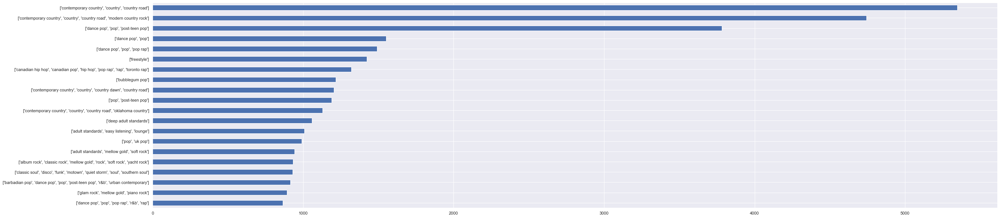

In [84]:
#sns.set()

tot_outer['spotify_genre'].replace('[]', np.nan).value_counts()[:20].plot(kind='barh', figsize=(40,10));
plt.gca().invert_yaxis()

#plt.figure(figsize=(60,10));
#plt.rcParams['figure.figsize']=(80,10)

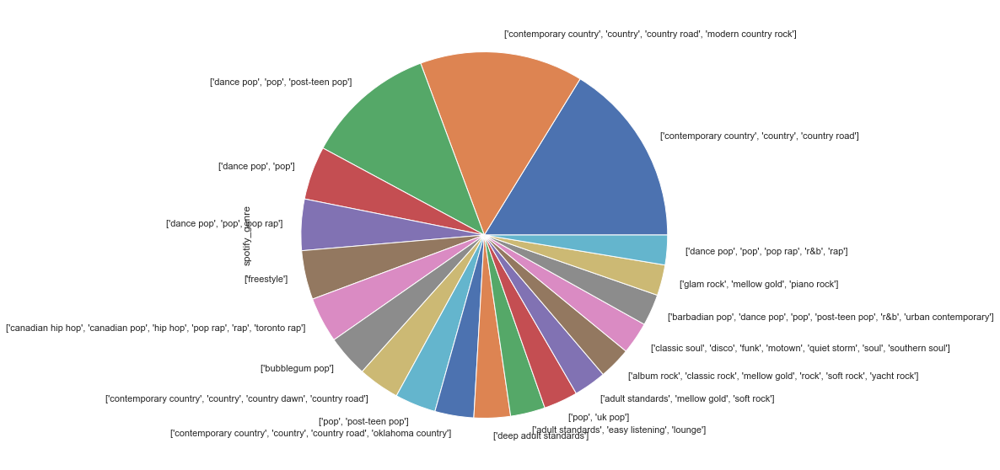

In [85]:
tot_outer['spotify_genre'].replace('[]', np.nan).value_counts()[:20].plot.pie();

In [86]:
top_20_genre = tot_outer['spotify_genre'].replace('[]', np.nan).value_counts()[:20]
print(top_20_genre.index)
print(top_20_genre.sum())

Index(['['contemporary country', 'country', 'country road']',
       '['contemporary country', 'country', 'country road', 'modern country rock']',
       '['dance pop', 'pop', 'post-teen pop']', '['dance pop', 'pop']',
       '['dance pop', 'pop', 'pop rap']', '['freestyle']',
       '['canadian hip hop', 'canadian pop', 'hip hop', 'pop rap', 'rap', 'toronto rap']',
       '['bubblegum pop']',
       '['contemporary country', 'country', 'country dawn', 'country road']',
       '['pop', 'post-teen pop']',
       '['contemporary country', 'country', 'country road', 'oklahoma country']',
       '['deep adult standards']',
       '['adult standards', 'easy listening', 'lounge']', '['pop', 'uk pop']',
       '['adult standards', 'mellow gold', 'soft rock']',
       '['album rock', 'classic rock', 'mellow gold', 'rock', 'soft rock', 'yacht rock']',
       '['classic soul', 'disco', 'funk', 'motown', 'quiet storm', 'soul', 'southern soul']',
       '['barbadian pop', 'dance pop', 'pop', 'post

In [87]:
top_20_genre

['contemporary country', 'country', 'country road']                                    5347
['contemporary country', 'country', 'country road', 'modern country rock']             4742
['dance pop', 'pop', 'post-teen pop']                                                  3782
['dance pop', 'pop']                                                                   1552
['dance pop', 'pop', 'pop rap']                                                        1491
['freestyle']                                                                          1424
['canadian hip hop', 'canadian pop', 'hip hop', 'pop rap', 'rap', 'toronto rap']       1319
['bubblegum pop']                                                                      1217
['contemporary country', 'country', 'country dawn', 'country road']                    1203
['pop', 'post-teen pop']                                                               1190
['contemporary country', 'country', 'country road', 'oklahoma country']         

In [88]:
options = list(top_20_genre.index)
options

["['contemporary country', 'country', 'country road']",
 "['contemporary country', 'country', 'country road', 'modern country rock']",
 "['dance pop', 'pop', 'post-teen pop']",
 "['dance pop', 'pop']",
 "['dance pop', 'pop', 'pop rap']",
 "['freestyle']",
 "['canadian hip hop', 'canadian pop', 'hip hop', 'pop rap', 'rap', 'toronto rap']",
 "['bubblegum pop']",
 "['contemporary country', 'country', 'country dawn', 'country road']",
 "['pop', 'post-teen pop']",
 "['contemporary country', 'country', 'country road', 'oklahoma country']",
 "['deep adult standards']",
 "['adult standards', 'easy listening', 'lounge']",
 "['pop', 'uk pop']",
 "['adult standards', 'mellow gold', 'soft rock']",
 "['album rock', 'classic rock', 'mellow gold', 'rock', 'soft rock', 'yacht rock']",
 "['classic soul', 'disco', 'funk', 'motown', 'quiet storm', 'soul', 'southern soul']",
 "['barbadian pop', 'dance pop', 'pop', 'post-teen pop', 'r&b', 'urban contemporary']",
 "['glam rock', 'mellow gold', 'piano rock']

In [89]:
top_20_genre_df = tot_outer[tot_outer['spotify_genre'].isin(options)]

In [93]:
top_20_genre_df.count()

url                          32926
WeekID                       32926
Week Position                32926
Song_x                       32926
Performer_x                  32926
SongID                       32926
Instance                     32926
Previous Week Position       30200
Peak Position                32926
Weeks on Chart               32926
Performer_y                  32926
Song_y                       32926
spotify_genre                32926
spotify_track_id             31544
spotify_track_preview_url    16634
spotify_track_duration_ms    31544
spotify_track_explicit       31544
spotify_track_album          31544
danceability                 31536
energy                       31536
key                          31536
loudness                     31536
mode                         31536
speechiness                  31536
acousticness                 31536
instrumentalness             31536
liveness                     31536
valence                      31536
tempo               

In [95]:
#Number of Unique values by Column
top_20_genre_df.apply(pd.Series.nunique)

url                          3237
WeekID                       3237
Week Position                 100
Song_x                       2349
Performer_x                   415
SongID                       2398
Instance                        6
Previous Week Position        100
Peak Position                 100
Weeks on Chart                 68
Performer_y                   415
Song_y                       2349
spotify_genre                  20
spotify_track_id             2233
spotify_track_preview_url    1138
spotify_track_duration_ms    2070
spotify_track_explicit          2
spotify_track_album           988
danceability                  589
energy                        718
key                            12
loudness                     1995
mode                            2
speechiness                   698
acousticness                 1288
instrumentalness              981
liveness                      809
valence                       819
tempo                        2178
time_signature

In [417]:
top_20_genre_df['spotify_genre']

0                                    ['deep adult standards']
1                                    ['deep adult standards']
2                                    ['deep adult standards']
3                                    ['deep adult standards']
4                                    ['deep adult standards']
                                 ...                         
330052    ['contemporary country', 'country', 'country road']
330053    ['contemporary country', 'country', 'country road']
330054    ['contemporary country', 'country', 'country road']
330055    ['contemporary country', 'country', 'country road']
330056    ['contemporary country', 'country', 'country road']
Name: spotify_genre, Length: 32926, dtype: object

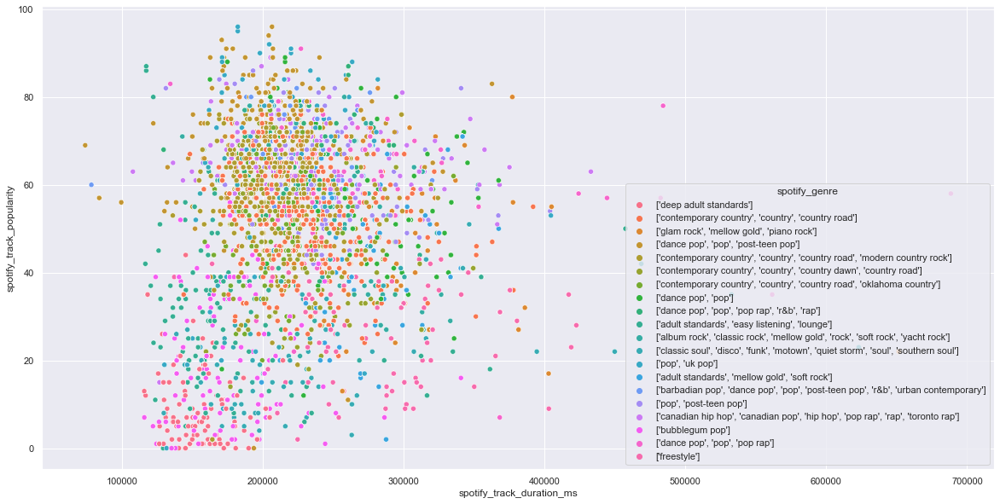

In [419]:
sns.scatterplot(data=top_20_genre_df, 
                x='spotify_track_duration_ms', 
                y='spotify_track_popularity', 
                hue='spotify_genre');

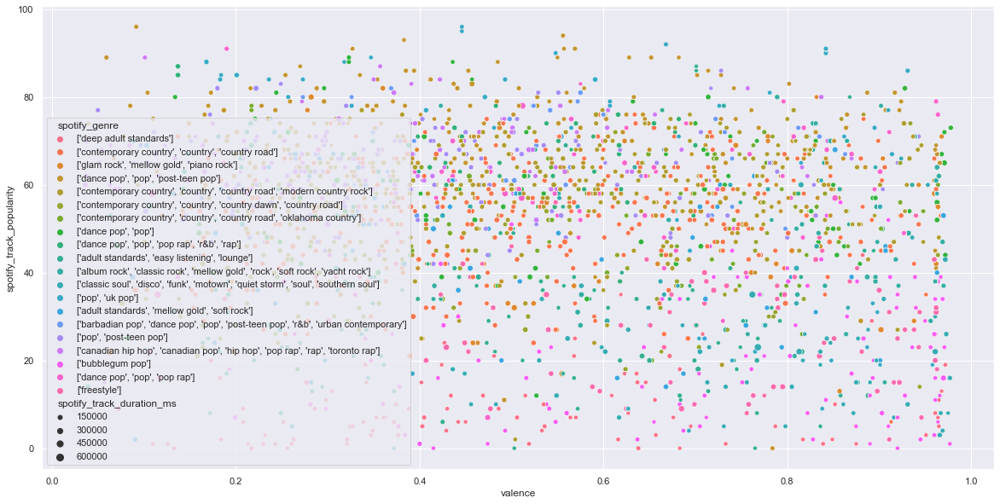

In [420]:
sns.scatterplot(data=top_20_genre_df, 
                x='valence', 
                y='spotify_track_popularity', 
                hue='spotify_genre',
                size='spotify_track_duration_ms');

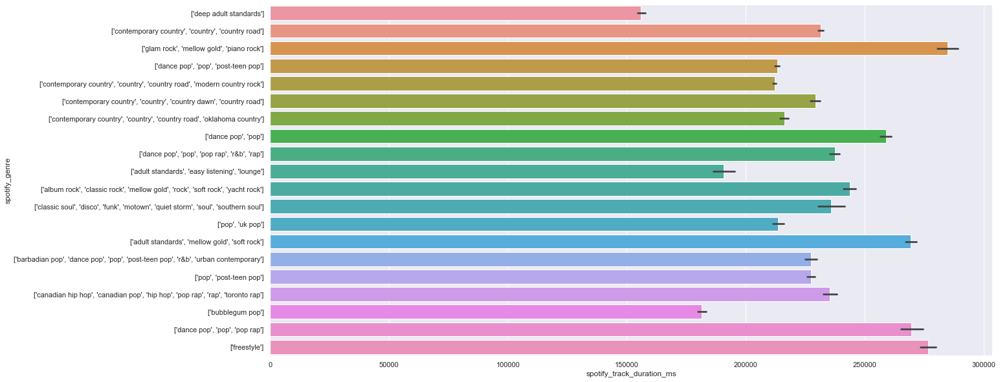

In [423]:
sns.color_palette('rocket', as_cmap=True)
sns.barplot(y='spotify_genre', x='spotify_track_duration_ms', data=top_20_genre_df);

In [ ]:
import plotly.express as px
df = px.data.iris()
fig = px.scatter_3d(df, x='sepal_length', y='sepal_width', z='petal_width',
              color='species')
fig.show()

In [281]:
bub_gum = tot_outer['spotify_genre']=="['bubblegum pop']"
bub_gum

0         False
1         False
2         False
3         False
4         False
          ...  
330459    False
330460    False
330461    False
330462    False
330463    False
Name: spotify_genre, Length: 330464, dtype: bool

In [282]:
bub_gum.value_counts()

False    329247
True       1217
Name: spotify_genre, dtype: int64

In [286]:
bubble_gum = tot_outer[bub_gum]
bubble_gum.sort_values(by='WeekID')

,url,WeekID,Week Position,Song_x,Performer_x,SongID,Instance,Previous Week Position,Peak Position,Weeks on Chart,Performer_y,Song_y,spotify_genre,spotify_track_id,spotify_track_preview_url,spotify_track_duration_ms,spotify_track_explicit,spotify_track_album,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,spotify_track_popularity
177843,http://www.billboard.com/charts/hot-100/1966-08-13,1966-08-13,100.0,Black Is Black,Los Bravos,Black Is BlackLos Bravos,1.0,NaN,100.0,1.0,Los Bravos,Black Is Black,['bubblegum pop'],6lazLV13sV8VNGJTjL4Zeu,https://p.scdn.co/mp3-preview/6b27918850057df603ba9e55a7448d099a9035bf?cid=b8d3901151d34489a160e3cf0ab1fa94,176600.0,0.0,Black Is Black,0.575,0.843,2.0,-5.931,1.0,0.0584,0.239,0.000005,0.0764,0.858,128.169,4.0,56.0
177845,http://www.billboard.com/charts/hot-100/1966-08-20,1966-08-20,82.0,Black Is Black,Los Bravos,Black Is BlackLos Bravos,1.0,100.0,82.0,2.0,Los Bravos,Black Is Black,['bubblegum pop'],6lazLV13sV8VNGJTjL4Zeu,https://p.scdn.co/mp3-preview/6b27918850057df603ba9e55a7448d099a9035bf?cid=b8d3901151d34489a160e3cf0ab1fa94,176600.0,0.0,Black Is Black,0.575,0.843,2.0,-5.931,1.0,0.0584,0.239,0.000005,0.0764,0.858,128.169,4.0,56.0
177844,http://www.billboard.com/charts/hot-100/1966-08-27,1966-08-27,63.0,Black Is Black,Los Bravos,Black Is BlackLos Bravos,1.0,82.0,63.0,3.0,Los Bravos,Black Is Black,['bubblegum pop'],6lazLV13sV8VNGJTjL4Zeu,https://p.scdn.co/mp3-preview/6b27918850057df603ba9e55a7448d099a9035bf?cid=b8d3901151d34489a160e3cf0ab1fa94,176600.0,0.0,Black Is Black,0.575,0.843,2.0,-5.931,1.0,0.0584,0.239,0.000005,0.0764,0.858,128.169,4.0,56.0
177852,http://www.billboard.com/charts/hot-100/1966-09-03,1966-09-03,41.0,Black Is Black,Los Bravos,Black Is BlackLos Bravos,1.0,63.0,41.0,4.0,Los Bravos,Black Is Black,['bubblegum pop'],6lazLV13sV8VNGJTjL4Zeu,https://p.scdn.co/mp3-preview/6b27918850057df603ba9e55a7448d099a9035bf?cid=b8d3901151d34489a160e3cf0ab1fa94,176600.0,0.0,Black Is Black,0.575,0.843,2.0,-5.931,1.0,0.0584,0.239,0.000005,0.0764,0.858,128.169,4.0,56.0
177850,http://www.billboard.com/charts/hot-100/1966-09-10,1966-09-10,27.0,Black Is Black,Los Bravos,Black Is BlackLos Bravos,1.0,41.0,27.0,5.0,Los Bravos,Black Is Black,['bubblegum pop'],6lazLV13sV8VNGJTjL4Zeu,https://p.scdn.co/mp3-preview/6b27918850057df603ba9e55a7448d099a9035bf?cid=b8d3901151d34489a160e3cf0ab1fa94,176600.0,0.0,Black Is Black,0.575,0.843,2.0,-5.931,1.0,0.0584,0.239,0.000005,0.0764,0.858,128.169,4.0,56.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
240320,http://www.billboard.com/charts/hot-100/1990-12-08,1990-12-08,52.0,Lyin' To Myself,David Cassidy,Lyin' To MyselfDavid Cassidy,1.0,43.0,27.0,12.0,David Cassidy,Lyin' To Myself,['bubblegum pop'],3gdD2aleRK8NMD3sgDCaQO,NaN,227160.0,0.0,Then And Now,0.853,0.493,7.0,-6.636,1.0,0.0314,0.385,0.000044,0.1120,0.377,100.059,4.0,5.0
240317,http://www.billboard.com/charts/hot-100/1990-12-15,1990-12-15,73.0,Lyin' To Myself,David Cassidy,Lyin' To MyselfDavid Cassidy,1.0,52.0,27.0,13.0,David Cassidy,Lyin' To Myself,['bubblegum pop'],3gdD2aleRK8NMD3sgDCaQO,NaN,227160.0,0.0,Then And Now,0.853,0.493,7.0,-6.636,1.0,0.0314,0.385,0.000044,0.1120,0.377,100.059,4.0,5.0
240318,http://www.billboard.com/charts/hot-100/1990-12-22,1990-12-22,87.0,Lyin' To Myself,David Cassidy,Lyin' To MyselfDavid Cassidy,1.0,73.0,27.0,14.0,David Cassidy,Lyin' To Myself,['bubblegum pop'],3gdD2aleRK8NMD3sgDCaQO,NaN,227160.0,0.0,Then And Now,0.853,0.493,7.0,-6.636,1.0,0.0314,0.385,0.000044,0.1120,0.377,100.059,4.0,5.0
240314,http://www.billboard.com/charts/hot-100/1990-12-29,1990-12-29,87.0,Lyin' To Myself,David Cassidy,Lyin' To MyselfDavid Cassidy,1.0,87.0,27.0,15.0,David Cassidy,Lyin' To Myself,['bubblegum pop'],3gdD2aleRK8NMD3sgDCaQO,NaN,227160.0,0.0,Then And Now,0.853,0.493,7.0,-6.636,1.0,0.0314,0.385,0.000044,0.1120,0.377,100.059,4.0,5.0


In [284]:
bubble_gum['WeekID'].max()

Timestamp('1991-01-05 00:00:00')

In [285]:
bubble_gum['WeekID'].min()

Timestamp('1966-08-13 00:00:00')

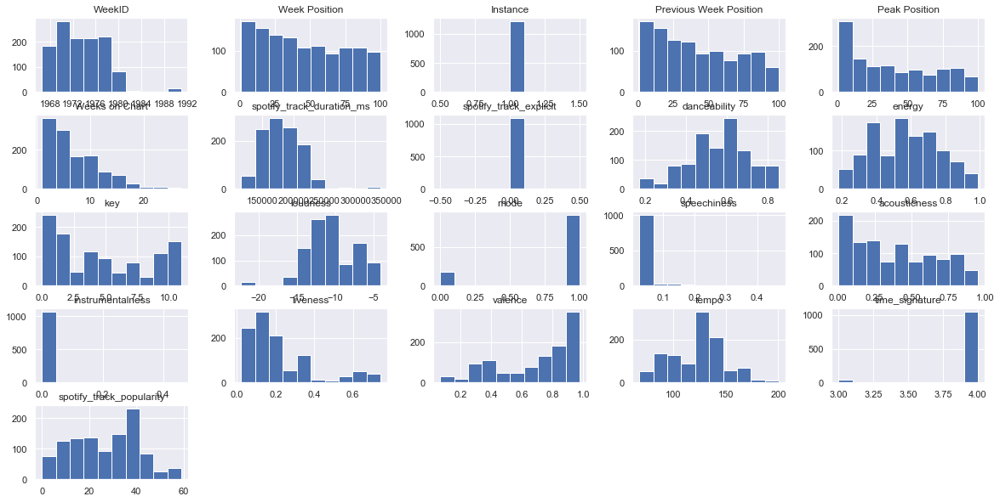

In [301]:
bubble_gum.hist();

In [287]:
bubble_gum_not_nan = bubble_gum[~bubble_gum['spotify_track_preview_url'].isna()]
bubble_gum_not_nan.sort_values(by='WeekID', ascending=False)

,url,WeekID,Week Position,Song_x,Performer_x,SongID,Instance,Previous Week Position,Peak Position,Weeks on Chart,Performer_y,Song_y,spotify_genre,spotify_track_id,spotify_track_preview_url,spotify_track_duration_ms,spotify_track_explicit,spotify_track_album,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,spotify_track_popularity
116521,http://www.billboard.com/charts/hot-100/1982-01-09,1982-01-09,84.0,Runaway Rita,Leif Garrett,Runaway RitaLeif Garrett,1.0,84.0,84.0,6.0,Leif Garrett,Runaway Rita,['bubblegum pop'],40nmiiOO6KT87CwLYwPkBh,https://p.scdn.co/mp3-preview/419c70b8a02914f27b5f101706d9e0bf8bf037f0?cid=b8d3901151d34489a160e3cf0ab1fa94,169533.0,0.0,The Leif Garrett Collection,0.628,0.693,2.0,-11.236,1.0,0.0301,0.0562,0.005020,0.1860,0.822,125.349,4.0,8.0
116520,http://www.billboard.com/charts/hot-100/1982-01-02,1982-01-02,84.0,Runaway Rita,Leif Garrett,Runaway RitaLeif Garrett,1.0,84.0,84.0,5.0,Leif Garrett,Runaway Rita,['bubblegum pop'],40nmiiOO6KT87CwLYwPkBh,https://p.scdn.co/mp3-preview/419c70b8a02914f27b5f101706d9e0bf8bf037f0?cid=b8d3901151d34489a160e3cf0ab1fa94,169533.0,0.0,The Leif Garrett Collection,0.628,0.693,2.0,-11.236,1.0,0.0301,0.0562,0.005020,0.1860,0.822,125.349,4.0,8.0
116519,http://www.billboard.com/charts/hot-100/1981-12-26,1981-12-26,84.0,Runaway Rita,Leif Garrett,Runaway RitaLeif Garrett,1.0,84.0,84.0,4.0,Leif Garrett,Runaway Rita,['bubblegum pop'],40nmiiOO6KT87CwLYwPkBh,https://p.scdn.co/mp3-preview/419c70b8a02914f27b5f101706d9e0bf8bf037f0?cid=b8d3901151d34489a160e3cf0ab1fa94,169533.0,0.0,The Leif Garrett Collection,0.628,0.693,2.0,-11.236,1.0,0.0301,0.0562,0.005020,0.1860,0.822,125.349,4.0,8.0
116518,http://www.billboard.com/charts/hot-100/1981-12-19,1981-12-19,84.0,Runaway Rita,Leif Garrett,Runaway RitaLeif Garrett,1.0,85.0,84.0,3.0,Leif Garrett,Runaway Rita,['bubblegum pop'],40nmiiOO6KT87CwLYwPkBh,https://p.scdn.co/mp3-preview/419c70b8a02914f27b5f101706d9e0bf8bf037f0?cid=b8d3901151d34489a160e3cf0ab1fa94,169533.0,0.0,The Leif Garrett Collection,0.628,0.693,2.0,-11.236,1.0,0.0301,0.0562,0.005020,0.1860,0.822,125.349,4.0,8.0
116517,http://www.billboard.com/charts/hot-100/1981-12-12,1981-12-12,85.0,Runaway Rita,Leif Garrett,Runaway RitaLeif Garrett,1.0,90.0,85.0,2.0,Leif Garrett,Runaway Rita,['bubblegum pop'],40nmiiOO6KT87CwLYwPkBh,https://p.scdn.co/mp3-preview/419c70b8a02914f27b5f101706d9e0bf8bf037f0?cid=b8d3901151d34489a160e3cf0ab1fa94,169533.0,0.0,The Leif Garrett Collection,0.628,0.693,2.0,-11.236,1.0,0.0301,0.0562,0.005020,0.1860,0.822,125.349,4.0,8.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
177850,http://www.billboard.com/charts/hot-100/1966-09-10,1966-09-10,27.0,Black Is Black,Los Bravos,Black Is BlackLos Bravos,1.0,41.0,27.0,5.0,Los Bravos,Black Is Black,['bubblegum pop'],6lazLV13sV8VNGJTjL4Zeu,https://p.scdn.co/mp3-preview/6b27918850057df603ba9e55a7448d099a9035bf?cid=b8d3901151d34489a160e3cf0ab1fa94,176600.0,0.0,Black Is Black,0.575,0.843,2.0,-5.931,1.0,0.0584,0.2390,0.000005,0.0764,0.858,128.169,4.0,56.0
177852,http://www.billboard.com/charts/hot-100/1966-09-03,1966-09-03,41.0,Black Is Black,Los Bravos,Black Is BlackLos Bravos,1.0,63.0,41.0,4.0,Los Bravos,Black Is Black,['bubblegum pop'],6lazLV13sV8VNGJTjL4Zeu,https://p.scdn.co/mp3-preview/6b27918850057df603ba9e55a7448d099a9035bf?cid=b8d3901151d34489a160e3cf0ab1fa94,176600.0,0.0,Black Is Black,0.575,0.843,2.0,-5.931,1.0,0.0584,0.2390,0.000005,0.0764,0.858,128.169,4.0,56.0
177844,http://www.billboard.com/charts/hot-100/1966-08-27,1966-08-27,63.0,Black Is Black,Los Bravos,Black Is BlackLos Bravos,1.0,82.0,63.0,3.0,Los Bravos,Black Is Black,['bubblegum pop'],6lazLV13sV8VNGJTjL4Zeu,https://p.scdn.co/mp3-preview/6b27918850057df603ba9e55a7448d099a9035bf?cid=b8d3901151d34489a160e3cf0ab1fa94,176600.0,0.0,Black Is Black,0.575,0.843,2.0,-5.931,1.0,0.0584,0.2390,0.000005,0.0764,0.858,128.169,4.0,56.

In [288]:
webbrowser.open('https://p.scdn.co/mp3-preview/419c70b8a02914f27b5f101706d9e0bf8bf037f0?cid=b8d3901151d34489a160e3cf0ab1fa94')

True

In [244]:
webbrowser.open('https://p.scdn.co/mp3-preview/727c536a70c3c319b871f37b9e2bd9aaee17da92?cid=b8d3901151d34489a160e3cf0ab1fa94')

True

In [ ]:
## Does URL link need to be convereted to wav file?? 

In [15]:
link = "https://p.scdn.co/mp3-preview/727c536a70c3c319b871f37b9e2bd9aaee17da92?cid=b8d3901151d34489a160e3cf0ab1fa94"

In [16]:
Audio(url = link, autoplay = False)

In [17]:
Audio(url="http://www.w3schools.com/html/horse.ogg")

In [ ]:
df.sort_values(by='url', ascending=False)

In [258]:
bubble_gum_not_nan.dtypes

url                                  object
WeekID                       datetime64[ns]
Week Position                       float64
Song_x                               object
Performer_x                          object
SongID                               object
Instance                            float64
Previous Week Position              float64
Peak Position                       float64
Weeks on Chart                      float64
Performer_y                          object
Song_y                               object
spotify_genre                        object
spotify_track_id                     object
spotify_track_preview_url            object
spotify_track_duration_ms           float64
spotify_track_explicit              float64
spotify_track_album                  object
danceability                        float64
energy                              float64
key                                 float64
loudness                            float64
mode                            

In [265]:
bubble_gum_not_nan.sort_values('WeekID')

,url,WeekID,Week Position,Song_x,Performer_x,SongID,Instance,Previous Week Position,Peak Position,Weeks on Chart,Performer_y,Song_y,spotify_genre,spotify_track_id,spotify_track_preview_url,spotify_track_duration_ms,spotify_track_explicit,spotify_track_album,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,spotify_track_popularity
177843,http://www.billboard.com/charts/hot-100/1966-08-13,1966-08-13,100.0,Black Is Black,Los Bravos,Black Is BlackLos Bravos,1.0,NaN,100.0,1.0,Los Bravos,Black Is Black,['bubblegum pop'],6lazLV13sV8VNGJTjL4Zeu,https://p.scdn.co/mp3-preview/6b27918850057df603ba9e55a7448d099a9035bf?cid=b8d3901151d34489a160e3cf0ab1fa94,176600.0,0.0,Black Is Black,0.575,0.843,2.0,-5.931,1.0,0.0584,0.2390,0.000005,0.0764,0.858,128.169,4.0,56.0
177845,http://www.billboard.com/charts/hot-100/1966-08-20,1966-08-20,82.0,Black Is Black,Los Bravos,Black Is BlackLos Bravos,1.0,100.0,82.0,2.0,Los Bravos,Black Is Black,['bubblegum pop'],6lazLV13sV8VNGJTjL4Zeu,https://p.scdn.co/mp3-preview/6b27918850057df603ba9e55a7448d099a9035bf?cid=b8d3901151d34489a160e3cf0ab1fa94,176600.0,0.0,Black Is Black,0.575,0.843,2.0,-5.931,1.0,0.0584,0.2390,0.000005,0.0764,0.858,128.169,4.0,56.0
177844,http://www.billboard.com/charts/hot-100/1966-08-27,1966-08-27,63.0,Black Is Black,Los Bravos,Black Is BlackLos Bravos,1.0,82.0,63.0,3.0,Los Bravos,Black Is Black,['bubblegum pop'],6lazLV13sV8VNGJTjL4Zeu,https://p.scdn.co/mp3-preview/6b27918850057df603ba9e55a7448d099a9035bf?cid=b8d3901151d34489a160e3cf0ab1fa94,176600.0,0.0,Black Is Black,0.575,0.843,2.0,-5.931,1.0,0.0584,0.2390,0.000005,0.0764,0.858,128.169,4.0,56.0
177852,http://www.billboard.com/charts/hot-100/1966-09-03,1966-09-03,41.0,Black Is Black,Los Bravos,Black Is BlackLos Bravos,1.0,63.0,41.0,4.0,Los Bravos,Black Is Black,['bubblegum pop'],6lazLV13sV8VNGJTjL4Zeu,https://p.scdn.co/mp3-preview/6b27918850057df603ba9e55a7448d099a9035bf?cid=b8d3901151d34489a160e3cf0ab1fa94,176600.0,0.0,Black Is Black,0.575,0.843,2.0,-5.931,1.0,0.0584,0.2390,0.000005,0.0764,0.858,128.169,4.0,56.0
177850,http://www.billboard.com/charts/hot-100/1966-09-10,1966-09-10,27.0,Black Is Black,Los Bravos,Black Is BlackLos Bravos,1.0,41.0,27.0,5.0,Los Bravos,Black Is Black,['bubblegum pop'],6lazLV13sV8VNGJTjL4Zeu,https://p.scdn.co/mp3-preview/6b27918850057df603ba9e55a7448d099a9035bf?cid=b8d3901151d34489a160e3cf0ab1fa94,176600.0,0.0,Black Is Black,0.575,0.843,2.0,-5.931,1.0,0.0584,0.2390,0.000005,0.0764,0.858,128.169,4.0,56.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
116517,http://www.billboard.com/charts/hot-100/1981-12-12,1981-12-12,85.0,Runaway Rita,Leif Garrett,Runaway RitaLeif Garrett,1.0,90.0,85.0,2.0,Leif Garrett,Runaway Rita,['bubblegum pop'],40nmiiOO6KT87CwLYwPkBh,https://p.scdn.co/mp3-preview/419c70b8a02914f27b5f101706d9e0bf8bf037f0?cid=b8d3901151d34489a160e3cf0ab1fa94,169533.0,0.0,The Leif Garrett Collection,0.628,0.693,2.0,-11.236,1.0,0.0301,0.0562,0.005020,0.1860,0.822,125.349,4.0,8.0
116518,http://www.billboard.com/charts/hot-100/1981-12-19,1981-12-19,84.0,Runaway Rita,Leif Garrett,Runaway RitaLeif Garrett,1.0,85.0,84.0,3.0,Leif Garrett,Runaway Rita,['bubblegum pop'],40nmiiOO6KT87CwLYwPkBh,https://p.scdn.co/mp3-preview/419c70b8a02914f27b5f101706d9e0bf8bf037f0?cid=b8d3901151d34489a160e3cf0ab1fa94,169533.0,0.0,The Leif Garrett Collection,0.628,0.693,2.0,-11.236,1.0,0.0301,0.0562,0.005020,0.1860,0.822,125.349,4.0,8.0
116519,http://www.billboard.com/charts/hot-100/1981-12-26,1981-12-26,84.0,Runaway Rita,Leif Garrett,Runaway RitaLeif Garrett,1.0,84.0,84.0,4.0,Leif Garrett,Runaway Rita,['bubblegum pop'],40nmiiOO6KT87CwLYwPkBh,https://p.scdn.co/mp3-preview/419c70b8a02914f27b5f101706d9e0bf8bf037f0?cid=b8d3901151d34489a160e3cf0ab1fa94,169533.0,0.0,The Leif Garrett Collection,0.628,0.693,2.0,-11.236,1.0,0.0301,0.0562,0.005020,0.1860,0.822,125.349,4.0,8.0
116520,http://www.bill

In [179]:
import webbrowser
webbrowser.open('https://p.scdn.co/mp3-preview/da2134a161f1cb34d17c2d6d7e77cc93d1c1e6f7?cid=b8d3901151d34489a160e3cf0ab1fa94')

True

In [425]:
tot_outer.head(3)

,url,WeekID,Week Position,Song_x,Performer_x,SongID,Instance,Previous Week Position,Peak Position,Weeks on Chart,Performer_y,Song_y,spotify_genre,spotify_track_id,spotify_track_preview_url,spotify_track_duration_ms,spotify_track_explicit,spotify_track_album,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,spotify_track_popularity
0,http://www.billboard.com/charts/hot-100/1965-07-17,1965-07-17,34.0,Don't Just Stand There,Patty Duke,Don't Just Stand TherePatty Duke,1.0,45.0,34.0,4.0,Patty Duke,Don't Just Stand There,['deep adult standards'],1YhNCQ3XOdTCZgubfX8PgB,NaN,163160.0,0.0,Lost Hits Of The 60's (All Original Artists & Versions),0.574,0.256,7.0,-15.044,1.0,0.0298,0.61,0.000077,0.1,0.568,82.331,3.0,21.0
1,http://www.billboard.com/charts/hot-100/1965-07-24,1965-07-24,22.0,Don't Just Stand There,Patty Duke,Don't Just Stand TherePatty Duke,1.0,34.0,22.0,5.0,Patty Duke,Don't Just Stand There,['deep adult standards'],1YhNCQ3XOdTCZgubfX8PgB,NaN,163160.0,0.0,Lost Hits Of The 60's (All Original Artists & Versions),0.574,0.256,7.0,-15.044,1.0,0.0298,0.61,0.000077,0.1,0.568,82.331,3.0,21.0
2,http://www.billboard.com/charts/hot-100/1965-07-31,1965-07-31,14.0,Don't Just Stand There,Patty Duke,Don't Just Stand TherePatty Duke,1.0,22.0,14.0,6.0,Patty Duke,Don't Just Stand There,['deep adult standards'],1YhNCQ3XOdTCZgubfX8PgB,NaN,163160.0,0.0,Lost Hits Of The 60's (All Original Artists & Versions),0.574,0.256,7.0,-15.044,1.0,0.0298,0.61,0.000077,0.1,0.568,82.331,3.0,21.0


In [510]:
df2_no_null.head(3)

,SongID,Performer,Song,spotify_genre,spotify_track_id,spotify_track_preview_url,spotify_track_duration_ms,spotify_track_explicit,spotify_track_album,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,spotify_track_popularity
2,......And Roses And RosesAndy Williams,Andy Williams,......And Roses And Roses,"['adult standards', 'brill building pop', 'easy listening', 'mellow gold']",3tvqPPpXyIgKrm4PR9HCf0,https://p.scdn.co/mp3-preview/cef4883cfd1e0e5312be7ccce98176cff46d7879?cid=b8d3901151d34489a160e3cf0ab1fa94,166106.0,0.0,The Essential Andy Williams,0.154,0.185,5.0,-14.063,1.0,0.0315,0.91100,0.000267,0.112,0.150,83.969,4.0,38.0
3,...And Then There Were DrumsSandy Nelson,Sandy Nelson,...And Then There Were Drums,"['rock-and-roll', 'space age pop', 'surf music']",1fHHq3qHU8wpRKHzhojZ4a,NaN,172066.0,0.0,Compelling Percussion,0.588,0.672,11.0,-17.278,0.0,0.0361,0.00256,0.745000,0.145,0.801,121.962,4.0,11.0
4,...Baby One More TimeBritney Spears,Britney Spears,...Baby One More Time,"['dance pop', 'pop', 'post-teen pop']",3MjUtNVVq3C8Fn0MP3zhXa,https://p.scdn.co/mp3-preview/da2134a161f1cb34d17c2d6d7e77cc93d1c1e6f7?cid=b8d3901151d34489a160e3cf0ab1fa94,211066.0,0.0,...Baby One More Time (Digital Deluxe Version),0.759,0.699,0.0,-5.745,0.0,0.0307,0.20200,0.000131,0.443,0.907,92.960,4.0,77.0


In [512]:
chosen = ["energy", "liveness", "tempo", "valence", "loudness", "speechiness", "acousticness", "danceability", "instrumentalness"]
songname = df2_no_null.SongID

# X = data_frame.drop(droppable, axis=1).values
X = df2_no_null[chosen].values
y = df2_no_null["danceability"].values

min_max_scaler = MinMaxScaler()
X = min_max_scaler.fit_transform(X)

pca = PCA(n_components=3)
pca.fit(X)

X = pca.transform(X)

import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.tools as tls

trace = go.Scatter3d(
    x=X[:,0],
    y=X[:,1],
    z=X[:,2],
    text=songname,
    mode="markers",
    marker=dict(
        size=8,
        color=y
    )
)

fig = go.Figure(data=[trace])
py.iplot(fig, filename="test-graph")


In [518]:
chosen = ["energy", "liveness", "tempo", "valence", "loudness", "speechiness", "acousticness", "danceability", "instrumentalness"]
preview = df2_url_no_null.spotify_track_preview_url

# X = data_frame.drop(droppable, axis=1).values
X = df2_url_no_null[chosen].values
y = df2_url_no_null["danceability"].values

min_max_scaler = MinMaxScaler()
X = min_max_scaler.fit_transform(X)

pca = PCA(n_components=3)
pca.fit(X)

X = pca.transform(X)

import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.tools as tls

trace = go.Scatter3d(
    x=X[:,0],
    y=X[:,1],
    z=X[:,2],
    text=preview,
    mode="markers",
    marker=dict(
        size=8,
        color=y
    )
)

fig = go.Figure(data=[trace])
py.iplot(fig, filename="test-graph")


### NaN Rows, To Reduce or Not to Reduce? 

In [112]:
nan_rows = tot_outer[tot_outer.isnull().any(axis=1)]
nan_rows.describe()

,Week Position,Instance,Previous Week Position,Peak Position,Weeks on Chart,spotify_track_duration_ms,spotify_track_explicit,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,spotify_track_popularity
count,177711.000000,177711.000000,145530.000000,177711.000000,177711.000000,1.343760e+05,134376.000000,133817.000000,133817.000000,133817.000000,133817.000000,133817.000000,133817.000000,133817.000000,133817.000000,133817.000000,133817.000000,133817.000000,133817.000000,134376.000000
mean,53.214162,1.081261,47.508754,44.815864,8.380083,2.277204e+05,0.138224,0.613097,0.631577,5.213501,-8.308608,0.716396,0.075498,0.259686,0.024256,0.187259,0.599215,119.832343,3.947324,48.547806
std,29.544030,0.381066,28.208679,31.063862,7.674809,6.420747e+04,0.345136,0.149762,0.193118,3.568215,3.601364,0.450748,0.084826,0.262349,0.113818,0.154781,0.234805,27.885664,0.292920,21.436890
min,1.000000,1.000000,1.000000,1.000000,1.000000,2.968800e+04,0.000000,0.000000,0.000581,0.000000,-28.030000,0.000000,0.000000,0.000003,0.000000,0.009670,0.000000,0.000000,0.000000,0.000000
25%,27.000000,1.000000,23.000000,15.000000,3.000000,1.868130e+05,0.000000,0.515000,0.496000,2.000000,-10.728000,0.000000,0.032400,0.040200,0.000000,0.088600,0.418000,99.009000,4.000000,33.000000
50%,55.000000,1.000000,47.000000,43.000000,6.000000,2.220660e+05,0.000000,0.620000,0.651000,5.000000,-7.691000,1.000000,0.041800,0.160000,0.000003,0.127000,0.617000,118.032000,4.000000,51.000000
75%,80.000000,1.000000,72.000000,72.000000,12.000000,2.583330e+05,0.000000,0.718000,0.785000,8.000000,-5.502000,1.000000,0.069700,0.422000,0.000287,0.243000,0.793000,135.530000,4.000000,65.000000
max,100.000000,10.000000,100.000000,100.000000,87.000000,3.079157e+06,1.000000,0.988000,0.997000,11.000000,2.291000,1.000000,0.951000,0.991000,0.982000,0.999000,0.991000,241.009000,5.000000,100.000000


In [113]:
ordered_df = tot_outer.sort_values(by='url', ascending=False)
reduced = ordered_df.head(int(len(ordered_df)*0.6616))

In [114]:
reduced.isnull().sum()

url                               0
WeekID                            0
Week Position                     0
Song_x                            0
Performer_x                       0
SongID                            0
Instance                          0
Previous Week Position        18516
Peak Position                     0
Weeks on Chart                    0
Performer_y                      78
Song_y                           78
spotify_genre                  8132
spotify_track_id              22883
spotify_track_preview_url    103929
spotify_track_duration_ms     22883
spotify_track_explicit        22883
spotify_track_album           22917
danceability                  23357
energy                        23357
key                           23357
loudness                      23357
mode                          23357
speechiness                   23357
acousticness                  23357
instrumentalness              23357
liveness                      23357
valence                     

In [149]:
reduced.describe()

,Week Position,Instance,Previous Week Position,Peak Position,Weeks on Chart,spotify_track_duration_ms,spotify_track_explicit,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,spotify_track_popularity
count,218634.000000,218634.000000,200118.000000,218634.000000,218634.000000,1.957510e+05,195751.000000,195277.000000,195277.000000,195277.000000,195277.000000,195277.000000,195277.000000,195277.000000,195277.000000,195277.000000,195277.000000,195277.000000,195277.000000,195751.000000
mean,50.381011,1.101819,47.372560,39.079535,10.693099,2.429976e+05,0.168898,0.640863,0.671071,5.304444,-7.371396,0.678580,0.081335,0.175455,0.016800,0.177603,0.568324,120.375576,3.974708,54.990222
std,28.875657,0.422181,27.732209,28.833217,8.449174,5.452655e+04,0.374663,0.142250,0.176787,3.583833,3.178778,0.467023,0.087796,0.204419,0.088652,0.144569,0.231954,27.825518,0.231398,18.465880
min,1.000000,1.000000,1.000000,1.000000,1.000000,2.968800e+04,0.000000,0.113000,0.020400,0.000000,-25.487000,0.000000,0.022000,0.000003,0.000000,0.013000,0.034900,36.710000,0.000000,0.000000
25%,25.000000,1.000000,23.000000,12.000000,4.000000,2.111060e+05,0.000000,0.548000,0.547000,2.000000,-9.198000,0.000000,0.032900,0.023600,0.000000,0.086700,0.384000,98.862000,4.000000,43.000000
50%,50.000000,1.000000,47.000000,36.000000,9.000000,2.366140e+05,0.000000,0.647000,0.689000,5.000000,-6.708000,1.000000,0.044400,0.091400,0.000002,0.122000,0.579000,119.054000,4.000000,57.000000
75%,75.000000,1.000000,71.000000,63.000000,15.000000,2.674260e+05,0.000000,0.741000,0.811000,8.000000,-5.027000,1.000000,0.081700,0.256000,0.000163,0.230000,0.756000,136.859000,4.000000,69.000000
max,100.000000,10.000000,100.000000,100.000000,87.000000,3.079157e+06,1.000000,0.988000,0.997000,11.000000,0.175000,1.000000,0.951000,0.990000,0.982000,0.997000,0.989000,213.737000,5.000000,100.000000
